# Problem Description

The goal of this project is to run regression analyses on COVID-19 time-series data. Specifically, the goal is to see what type of regression models work the best for individual US states, and to see if the models generated by the states can predict another seperate state.

The dataset used is from the NY Times COVID-19 GitHub Repository (https://github.com/nytimes/covid-19-data). The specific dataset is the United States state-level cumulative COVID-19 cases and deaths. It contains dates (by day), state names, FIPS (county) codes, cumulative number of cases and cumulative number of deaths. 

From the dataset, the number cases per day and the number of deaths per day will be found. The deaths per day measure wwill be used as the dependent variables for the regression models. This was intended because that was the metric used in a previous project. However, the cumulative number of deaths will  be used as well to compare.

The types of regression models that will be used will be ridge regression, LASSO regression and elastic-net regression. The results of ridge, LASSO and elastic-net regressions will be compared to see what kind of regularization work best overall and for each individual state. 

The results (predicitons) of the models that use the unfiltered (but preprocessed) dataset will be compared to the results of the individual state models.

Once the models have been trained and tuned, then the best type of model will be used to predict the values of another state that has not been included in the training.

# Data Preperation

For this dataset, some preproccessing was needed so that the dataset can be used. The following list describes what was done for preproccessing. This was all done in R.

1. Create date indexes
2. Create state indexes
3. Reorder dataset by state index 
4. Find the number of deaths per day
5. Find the number of cases per day
7. Find the 11 states with the most amount of data
8. Subset the dataset so that it only contains those states
9. Export the dataset

The following packages are imported for functions that will be used. 

In [159]:
import numpy as np
import pandas as pd
import seaborn as sn
import copy
import io # for importing data
import time # for timing the trainings
import matplotlib.pyplot as plt # plotting
from google.colab import files # upload files
from sklearn.preprocessing import scale
from sklearn import linear_model # for regression
from sklearn.metrics import mean_absolute_error, r2_score # evaluation tools
from sklearn.model_selection import train_test_split # to split into training and testing

The dataset intially as formatted as below.

In [ ]:
# read in data from upload
uploaded = files.upload()
inital_dataset = pd.read_csv(io.BytesIO(uploaded['us-states.csv']))
inital_dataset

Saving us-states.csv to us-states (1).csv


,Unnamed: 0,date,state,fips,cases,deaths,date_index,state_index,c_per_day,d_per_day,id
0,1,2020-01-21,Washington,53,1,0,1,52,1,0,1
1,2,2020-01-22,Washington,53,1,0,2,52,0,0,2
2,3,2020-01-23,Washington,53,1,0,3,52,0,0,3
3,4,2020-01-24,Illinois,17,1,0,4,15,1,0,4
4,5,2020-01-24,Washington,53,1,0,4,52,0,0,5
...,...,...,...,...,...,...,...,...,...,...,...
21239,21240,2021-03-23,Virginia,51,607234,10137,428,51,1265,8,21240
21240,21241,2021-03-23,Washington,53,359290,5249,428,52,563,17,21241
21241,21242,2021-03-23,West Virginia,54,138429,2613,428,53,327,1,21242
21242,21243,2021-03-23,Wisconsin,55,630040,7241,428,54,46,0,21243


The following R code was used for the preprocessing. First, the inital dataset was loaded, and then the dates were indexed. 

```
# read in initial data
data = read.csv("us-states.csv")

# find the unique dates
dates = unique(data$date)

# initialize the data index column
data$date_index = 0

# assign the date indexes to the proper dates
for(i in 1:nrow(data))
{
  for(j in 1:length(dates))
  {
    if(data$date[i] == dates[j])
    {
      data$date_index[i] = j
    }
  }
}
```

Then, the states are indexed.

```
# find the unique state names as sort them alphabetically
states = unique(data$state)
states = sort(states)

# initialize the state_index column
data$state_index = 0
# assign the state indexes to the appropriate state
for(i in 1:nrow(data))
{
  for(j in 1:length(states))
  {
    if(data$state[i] == states[j])
    {
      data$state_index[i] = j
    }
  }
}
```

Then, each row of the dataset is assigned a unique ID so that the change in the number of cases and the change in the number of deaths can be calculated. Then, additional columns are added to the dataset for those changes. Next, the data was ordered by state index, so that calculating the changes is easier.

```
# assign a unique id to each row
unique_id = seq(1, nrow(data))
data$id = unique_id

# initialize the cases per day and the deaths per day columns
data$c_per_day = 0
data$d_per_day = 0

# order the data by state index
data = data[order(data$state_index),]
```

The changes in cases and deaths are calculated.



```
# calculate the cases per day and the deaths per day
for(i in 1:nrow(data))
{
  if(i == 1) # for the first row, needs an exception
  {
    data$c_per_day[i] = data$cases[i]
    data$d_per_day[i] = data$deaths[i]
  }
  else
  {
    if(data$state_index[i] == data$state_index[i-1]) # if i is still in the same state as i-1
    {
      data$c_per_day[i] = data$cases[i] - data$cases[i-1]
      data$d_per_day[i] = data$deaths[i] - data$deaths[i-1]
    }
    if(data$state_index[i] != data$state_index[i-1]) # if i is not in the same state as i-1
    {
      data$c_per_day[i] = data$cases[i]
      data$d_per_day[i] = data$deaths[i]
    }
  }
}
```



Now, each state is checked to see which states have the most data. First, the number of rows for each dataset is found. Then, the vector that stored that data is ordered in decreasing order.



```
# create a matrix to store which states have the most data
n_states = matrix(nrow = length(states), ncol = 2)

# store the number of rows each state has
for(i in 1:length(states))
{
  temp = subset(data, state_index == i)
  n_states[i,1] = i
  n_states[i,2] = nrow(temp)
}

# reorder by nrow size, largest to smallest
n_states = n_states[order(-n_states[,2]),]
```



Then, the 11 states with the largest amounts of data are found.



```
# initialize vector to store the state indexes of the 11 states with the most data 
# (one extra for testing)
n_largest_list = c(0,0,0,0,0,0,0,0,0,0,0)

# store the indexes of the 11 states with the most data
for(i in 1:11)
{
  n_largest_list[i] = n_states[i]
}
```



Then, the dataset is subsetted using only the 11 states selected. 



```
# subset the state with the largest amount of data
data_new = subset(data, state_index == n_largest_list[1])

# iterate to obtain the data from the other states to form a new data-set
for(i in 2:11)
{
  temp = subset(data, state_index == n_largest_list[i])
  data_new = rbind(data_new, temp)
}
```



Finally, the new dataset's columns are reordered for ease of use in Python, and then the dataset is exported as a .csv file.



```
data_new = data_new[, c(10, 1, 2, 4, 5, 6, 7, 3, 8, 9)]

# export processed data
write.csv(data_new, "us-l11-states.csv")
```



Now that the data has been preprocessed, it is loaded into Python for use.

In [173]:
# read in data from upload
uploaded = files.upload()
DATA = pd.read_csv(io.BytesIO(uploaded['us-l11-states.csv']))

Saving us-l11-states.csv to us-l11-states (2).csv


The processed data is shown below.

In [ ]:
DATA

,Unnamed: 0,id,date,state,cases,deaths,date_index,state_index,fips,c_per_day,d_per_day
0,1,1,2020-01-21,Washington,1,0,1,52,53,1,0
1,2,2,2020-01-22,Washington,1,0,2,52,53,0,0
2,3,3,2020-01-23,Washington,1,0,3,52,53,0,0
3,5,5,2020-01-24,Washington,1,0,4,52,53,0,0
4,8,8,2020-01-25,Washington,1,0,5,52,53,0,0
...,...,...,...,...,...,...,...,...,...,...,...
4503,20979,20979,2021-03-19,Florida,1999249,32650,424,10,12,5140,53
4504,21034,21034,2021-03-20,Florida,2004354,32712,425,10,12,5105,62
4505,21089,21089,2021-03-21,Florida,2008341,32741,426,10,12,3987,29
4506,21144,21144,2021-03-22,Florida,2011203,32778,427,10,12,2862,37


The data is then split by the 10 states that will be used for training and tuning, and then the one state that will be used at the end as an independent set for testing the final models.

In [174]:
# split up data into the 10 largest states and into the last test state
state_10 = DATA[DATA.state_index == 10].to_numpy()
data_t10 = DATA[DATA.state_index != 10].to_numpy()

# remove data columns that will not be used (i.e., dates in YYYY/MM/DD format and state names)
data = data_t10[:, 6:11].astype(np.float64)

Each of the 10 states that will be used for training and tuning are plotted below to visualize their structures and differences. We will plot by cumulative number of deaths and by deaths per day.

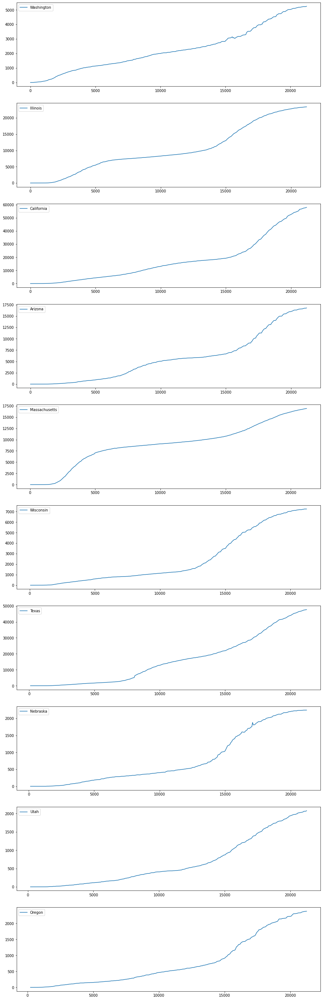

In [175]:
# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

unique_state_index_list = [52, 15,  5,  3, 23, 54, 47, 29, 48, 40, 10]

unique_state_name_list = ['Washington', 'Illinois', 'California', 'Arizona', 'Massachusetts', 
                          'Wisconsin', 'Texas', 'Nebraska', 'Utah', 'Oregon', 'Florida']

# plot each state
for i in range(10):
  temp = DATA[DATA.state_index == unique_state_index_list[i]].to_numpy()
  axes[i].plot(temp[:,0], temp[:,5], label = unique_state_name_list[i])
  axes[i].legend()

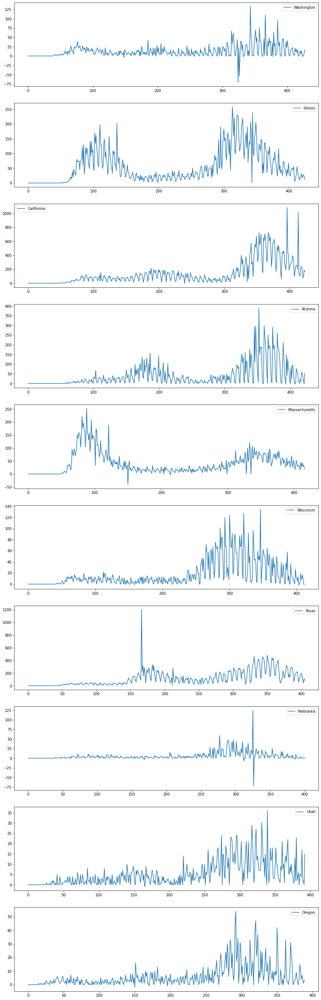

In [176]:
# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

# plot each state
for i in range(10):
  temp = DATA[DATA.state_index == unique_state_index_list[i]].to_numpy()
  axes[i].plot(temp[:,10], label = unique_state_name_list[i])
  axes[i].legend()

It can be seen that the states California, Arizona, Wisconsin, Utah and Oregon have similar structure. Washington and Texas also share similar structures, and Illionis and Massachusetts have similar structure. 

It can be seen that Washington, Texas and Nebraska are all states with some extreme outliers when compared to the other states. 

# Inital Analysis

In order to get a baseline understanding of how regression models will predict for this dataset, we will run Ordinary least-squares regression (OLS) on the whole dataset and then for the individual states.

After running OLS initally, the following will be analyzed using OLS models.
1. Compare cumulative counts with counts per day
2. Using PCA to compress the independent data
3. Data truncation for the first 50 days
4. Filter out large outliers in count per day data

We will start saving the results of the model predicitions here and for the tuned models.

MAE-> train : 31.960, test : 28.293
R2-> train : 0.508, test : 0.439
OLS took 0.007302284240722656 seconds


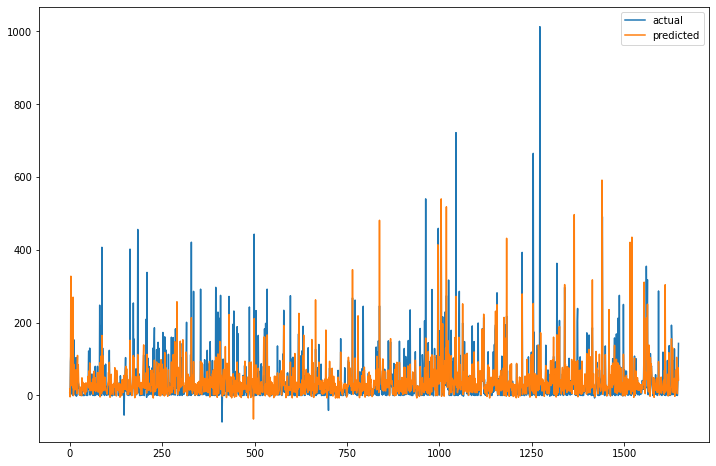

In [301]:
# save results
train_MAE_overall = []
test_MAE_overall = []
train_R2_overall = []
test_R2_overall = []

# split data into X and Y components
X_w = data[:, 0:4]
Y_w = data[:, 4]

start = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w, test_size = 0.4, random_state = 0)

# create model
model = linear_model.LinearRegression(normalize = True)

# fit model
model.fit(trainX, trainY)

# test model
trainPred = model.predict(trainX)
testPred = model.predict(testX)
train_MAE_overall.append(mean_absolute_error(trainY,trainPred))
test_MAE_overall.append(mean_absolute_error(testY,testPred))
train_R2_overall.append(r2_score(trainY,trainPred))
test_R2_overall.append(r2_score(testY,testPred))
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))

end = time.time()
print('OLS took', end - start, 'seconds')

plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred, label="predicted")
plt.legend()
plt.show()

It can be seen that for the overall data model, the $R^2$ score for the training set is 0.508 and for the testing set is 0.439. Despite that, the mean absolute error (MAE) of the testing set is less than the MAE of the training set.

Now, we will find the OLS models for each of the 10 states to see if the error decreases and/or the $R^2$ score increases. We will also start storing the MAE values and $R^2$ values here for each state.

state index = 52
state = Washington
MAE-> train : 8.918, test : 10.479
R2-> train : 0.155, test : 0.127
     
state index = 15
state = Illinois
MAE-> train : 33.189, test : 28.212
R2-> train : 0.434, test : 0.478
     
state index = 5
state = California
MAE-> train : 80.405, test : 80.084
R2-> train : 0.467, test : 0.489
     
state index = 3
state = Arizona
MAE-> train : 26.364, test : 31.464
R2-> train : 0.430, test : 0.283
     
state index = 23
state = Massachusetts
MAE-> train : 26.596, test : 26.416
R2-> train : 0.273, test : 0.229
     
state index = 54
state = Wisconsin
MAE-> train : 10.380, test : 10.817
R2-> train : 0.532, test : 0.572
     
state index = 47
state = Texas
MAE-> train : 56.044, test : 47.043
R2-> train : 0.392, test : 0.632
     
state index = 29
state = Nebraska
MAE-> train : 3.774, test : 5.147
R2-> train : 0.453, test : 0.134
     
state index = 48
state = Utah
MAE-> train : 3.160, test : 2.864
R2-> train : 0.466, test : 0.519
     
state index = 40
state =

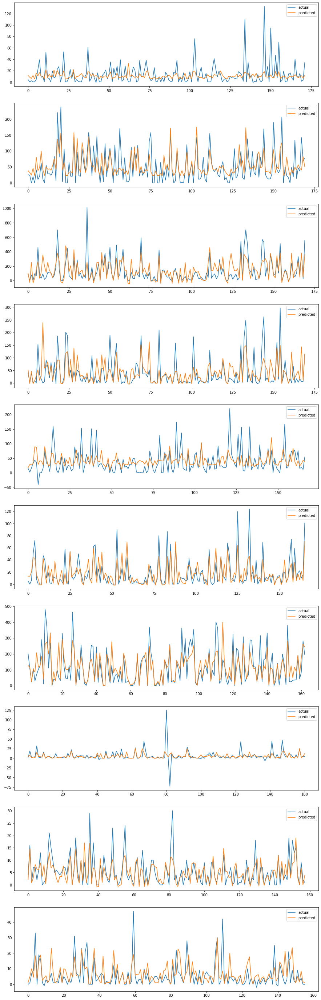

In [303]:
# create matrix to store results in for each state
train_MAE_indiv = [[j for i in range(2)] for j in range(10)]
test_MAE_indiv = [[j for i in range(2)] for j in range(10)]
train_R2_indiv = [[j for i in range(2)] for j in range(10)]
test_R2_indiv = [[j for i in range(2)] for j in range(10)]

# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

# run OLS on each state
start_1 = time.time() # time how long it takes to find the models
for i in range(10):
  # create temporary dataset
  temp = DATA[DATA.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 10]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model = linear_model.LinearRegression(normalize = True)

  # fit model
  model.fit(trainX, trainY)

  # test model
  trainPred = model.predict(trainX)
  testPred = model.predict(testX)
  train_MAE_indiv[i].append(mean_absolute_error(trainY,trainPred))
  test_MAE_indiv[i].append(mean_absolute_error(testY,testPred))
  train_R2_indiv[i].append(r2_score(trainY,trainPred))
  test_R2_indiv[i].append(r2_score(testY,testPred))
  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('     ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end_1 = time.time()
print('Finding all of the OLS models took', end_1 - start_1, 'seconds')

It can be seen that for several of the states, such as Wisconsin, Texas, and Utah, finding the OLS for those indivdual improves the error and the predictions. However, it can also be seen that this has the opposite effect on Washington, Arizona, and Massachusetts. This is because the data for those states have similar structure, where there are some distinct outliers. 

### Cumulative Data vs. Count Per Day Data

We will now see if using the cumulative death count as the dependent variable of the regression models will do better than using deaths per day values as the dependent variable of the regression models. We will check this for the whole dataset and for each state.

We will also save the results of the models in a seperate list than the count per day data.

MAE-> train : 4346.955, test : 4095.305
R2-> train : 0.496, test : 0.478
OLS took 0.008933544158935547 seconds


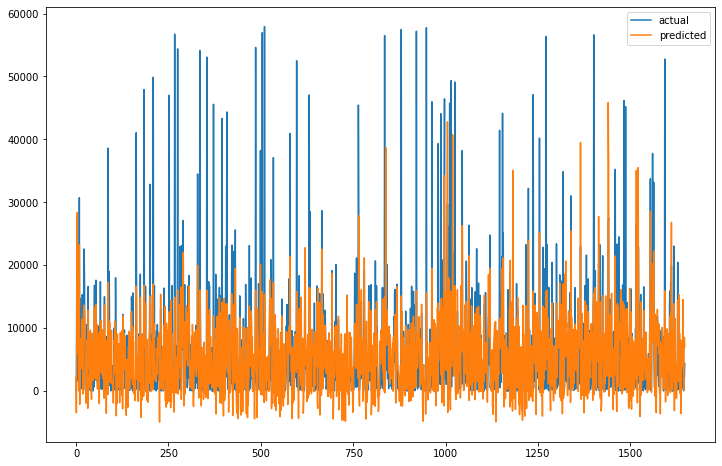

In [304]:
# save results
train_MAE_overall_c = []
test_MAE_overall_c = []
train_R2_overall_c = []
test_R2_overall_c = []

X_w_c = data[:, 0:4]
Y_w_c = data_t10[:, 5]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w_c, Y_w_c, test_size = 0.4, random_state = 0)

start = time.time()

# create model
model = linear_model.LinearRegression(normalize = True)

# fit model
model.fit(trainX, trainY)

# test model
trainPred = model.predict(trainX)
testPred = model.predict(testX)
train_MAE_overall_c.append(mean_absolute_error(trainY,trainPred))
test_MAE_overall_c.append(mean_absolute_error(testY,testPred))
train_R2_overall_c.append(r2_score(trainY,trainPred))
test_R2_overall_c.append(r2_score(testY,testPred))
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))

end = time.time()
print('OLS took', end - start, 'seconds')

plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred, label="predicted")
plt.legend()
plt.show()

It can be seen that the MAE values for this models are significantly larger than those for the models that used deaths per day instead of cumulative deaths.

Now we will repeat this for each individual state.

state index = 52
state = Washington
MAE-> train : 233.183, test : 236.929
R2-> train : 0.965, test : 0.966
     
state index = 15
state = Illinois
MAE-> train : 1223.533, test : 1306.159
R2-> train : 0.958, test : 0.953
     
state index = 5
state = California
MAE-> train : 5043.491, test : 4948.802
R2-> train : 0.871, test : 0.861
     
state index = 3
state = Arizona
MAE-> train : 1355.673, test : 1387.477
R2-> train : 0.901, test : 0.898
     
state index = 23
state = Massachusetts
MAE-> train : 904.045, test : 957.754
R2-> train : 0.948, test : 0.943
     
state index = 54
state = Wisconsin
MAE-> train : 740.512, test : 731.058
R2-> train : 0.878, test : 0.871
     
state index = 47
state = Texas
MAE-> train : 3662.672, test : 3674.166
R2-> train : 0.924, test : 0.918
     
state index = 29
state = Nebraska
MAE-> train : 225.146, test : 231.631
R2-> train : 0.890, test : 0.866
     
state index = 48
state = Utah
MAE-> train : 183.350, test : 179.640
R2-> train : 0.894, test : 0.901

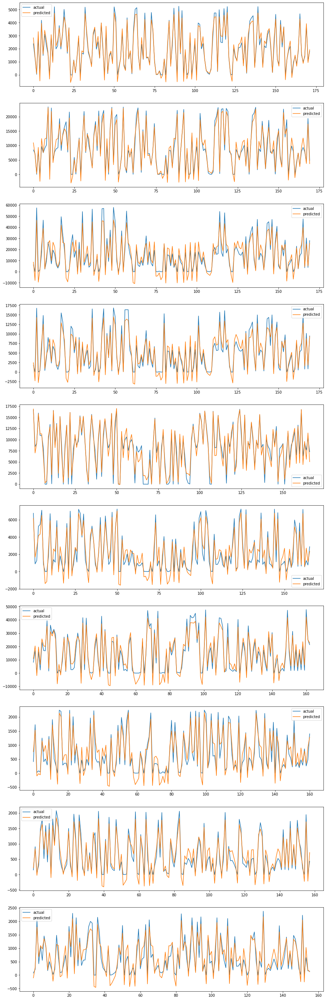

In [305]:
# create matrix to store results in for each state
train_MAE_indiv_c = [[j for i in range(2)] for j in range(10)]
test_MAE_indiv_c = [[j for i in range(2)] for j in range(10)]
train_R2_indiv_c = [[j for i in range(2)] for j in range(10)]
test_R2_indiv_c = [[j for i in range(2)] for j in range(10)]

# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

# run OLS on each state
start_1 = time.time() # time how long it takes to find the models
for i in range(10):
  # create temporary dataset
  temp = DATA[DATA.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 5]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model = linear_model.LinearRegression(normalize = True)

  # fit model
  model.fit(trainX, trainY)

  # test model
  trainPred = model.predict(trainX)
  testPred = model.predict(testX)
  train_MAE_indiv_c[i].append(mean_absolute_error(trainY,trainPred))
  test_MAE_indiv_c[i].append(mean_absolute_error(testY,testPred))
  train_R2_indiv_c[i].append(r2_score(trainY,trainPred))
  test_R2_indiv_c[i].append(r2_score(testY,testPred))
  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('     ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end_1 = time.time()
print('Finding all of the OLS models took', end_1 - start_1, 'seconds')

We can see that using the cumulative data leads to models that are much better at predicting than models that use per day data. 

### Principle Component Analysis

Principle component analysis (PCA) is a dimensionality-reduction method that takes data and splits it into components that explain a certain amount of the data.

Since the dimension of our data is low (i.e. 4 or 5), we should be able to attain single principle component that contains the majority of the variation in the data. We will check if that principle component will help with the model predicitons. 

First, we will use the PCA class from https://github.com/rtwhite1546/Spring-2021-Intro-to-Machine-Learning/blob/main/Week-9-PCA-Decision-Trees/Week9.ipynb.

In [306]:
# Principal component analysis
def PCA(X, alpha):        
    # find the original dimension and print it
    dimension = X.shape[1]
    print('The original dimension of the data is', dimension)
    
    # center D to have mean 0
    X -= np.mean(X, axis=0)
    
    # compute the covariance matrix
    Sigma = (1/X.shape[0]) * X.T @ X

    # compute the eigenvalues and eigenvectors of D^T D
    (eValues, eVectors) = np.linalg.eigh(Sigma)

    # compute the total variance
    varX = np.sum(eValues)
    
    # initialize the variance for A to 0
    varA = 0.0
    
    # reverse eValues and eVectors
    eValues = np.flip(eValues)
    eVectors = np.flip(eVectors, axis=1)

    # find the minimum dimension consisting of fraction at least alpha of the total variance
    for r in np.arange(0, eValues.shape[0]):
        varA += eValues[r]
        ratio = varA/varX

        if ratio > alpha:
            dimension = r + 1
            print('The new dimension of the data is', dimension, 'and it explains', ratio, 'of the variance')
            break
            
    # construct the new basis
    basis = eVectors[:,:dimension]
    
    # create the datapoints in the new space
    A = X @ basis
    
    # return points
    return A

Then, we use the overall dataset with the counts per day data.

The original dimension of the data is 4
The new dimension of the data is 1 and it explains 0.999532245510982 of the variance
PCA took 0.003032207489013672 seconds
MAE-> train : 32.646, test : 29.230
R2-> train : 0.492, test : 0.410
OLS took 0.013072013854980469 seconds


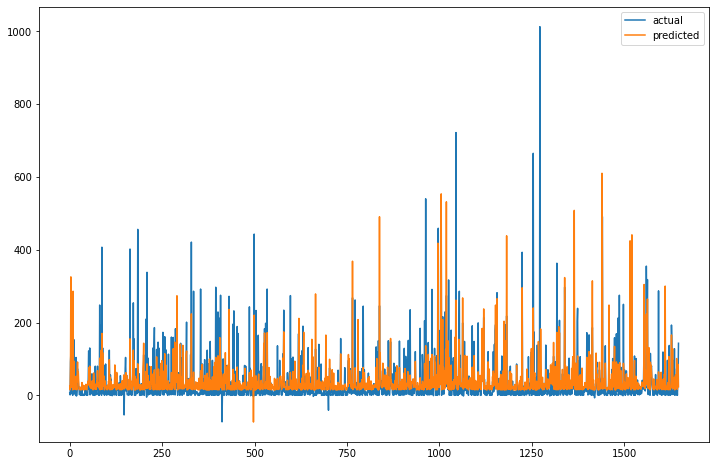

In [307]:
start = time.time()

# Apply PCA to the data matrices
X_pca = PCA(X_w, 0.8)

end = time.time()
print('PCA took', end-start, 'seconds')

start = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_pca, Y_w, test_size = 0.4, random_state = 0)

# create model
model = linear_model.LinearRegression(normalize = True)

# fit model
model.fit(trainX, trainY)

# test model
trainPred = model.predict(trainX)
testPred = model.predict(testX)
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))

end = time.time()
print('OLS took', end - start, 'seconds')

plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred, label="predicted")
plt.legend()
plt.show()

We will also now do this for the individual states using the counts per day data.

The original dimension of the data is 4
The new dimension of the data is 1 and it explains 0.989053376596971 of the variance
PCA took 0.0010647773742675781 seconds
state index = 52
state = Washington
MAE-> train : 8.952, test : 10.483
R2-> train : 0.151, test : 0.119
     
The original dimension of the data is 4
The new dimension of the data is 1 and it explains 0.9988880488180357 of the variance
PCA took 0.0013556480407714844 seconds
state index = 15
state = Illinois
MAE-> train : 33.165, test : 28.131
R2-> train : 0.434, test : 0.478
     
The original dimension of the data is 4
The new dimension of the data is 1 and it explains 0.9999228216473374 of the variance
PCA took 0.0007402896881103516 seconds
state index = 5
state = California
MAE-> train : 92.608, test : 90.515
R2-> train : 0.294, test : 0.343
     
The original dimension of the data is 4
The new dimension of the data is 1 and it explains 0.9983779009279486 of the variance
PCA took 0.0006747245788574219 seconds
state index 

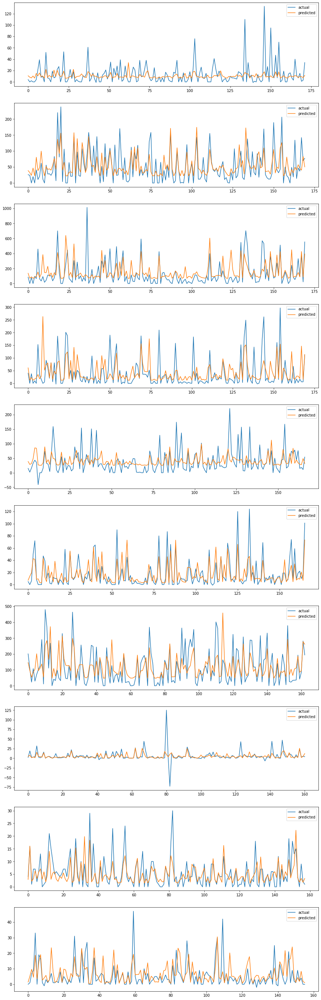

In [308]:
# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

# run OLS on each state
start_1 = time.time() # time how long it takes to find the models
for i in range(10):
  # create temporary dataset
  temp = DATA[DATA.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10].astype(np.float64)
  Y = temp[:, 10].astype(np.float64)

  startPCA = time.time()

  # Apply PCA to the data matrices
  X_pca_i = PCA(X, 0.8)

  endPCA = time.time()
  print('PCA took', endPCA-startPCA, 'seconds')

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X_pca_i, Y, test_size = 0.4, random_state = 0)

  # create model
  model = linear_model.LinearRegression(normalize = True)

  # fit model
  model.fit(trainX, trainY)

  # test model
  trainPred = model.predict(trainX)
  testPred = model.predict(testX)
  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('     ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end_1 = time.time()

We can see here that PCA does not help the indivdual state models, for any of the states. 

Now, lets check the cumulative count versions of the models.

The original dimension of the data is 4
The new dimension of the data is 1 and it explains 0.9995322455109817 of the variance
PCA took 0.003246784210205078 seconds
MAE-> train : 5102.066, test : 4958.381
R2-> train : 0.322, test : 0.273
OLS took 0.005734682083129883 seconds


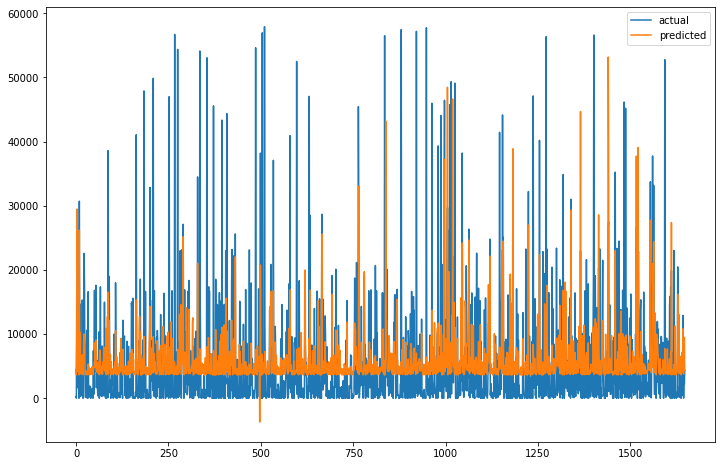

In [309]:
start = time.time()

# Apply PCA to the data matrices
X_pca = PCA(X_w_c, 0.8)

end = time.time()
print('PCA took', end-start, 'seconds')

start = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_pca, Y_w_c, test_size = 0.4, random_state = 0)

# create model
model = linear_model.LinearRegression(normalize = True)

# fit model
model.fit(trainX, trainY)

# test model
trainPred = model.predict(trainX)
testPred = model.predict(testX)
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))

end = time.time()
print('OLS took', end - start, 'seconds')

plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred, label="predicted")
plt.legend()
plt.show()

It can be seen that here, PCA does absolutely no help in predicting cumulative number of deaths for the overall dataset.

Now we will look at the indivdual state data using the cumulative count.

The original dimension of the data is 4
The new dimension of the data is 1 and it explains 0.989053376596971 of the variance
PCA took 0.000629425048828125 seconds
state index = 52
state = Washington
MAE-> train : 993.557, test : 1054.463
R2-> train : 0.249, test : 0.242
     
The original dimension of the data is 4
The new dimension of the data is 1 and it explains 0.9988880488180357 of the variance
PCA took 0.0008294582366943359 seconds
state index = 15
state = Illinois
MAE-> train : 5137.312, test : 4908.431
R2-> train : 0.138, test : 0.205
     
The original dimension of the data is 4
The new dimension of the data is 1 and it explains 0.9999228216473374 of the variance
PCA took 0.0020101070404052734 seconds
state index = 5
state = California
MAE-> train : 11207.736, test : 10671.139
R2-> train : 0.121, test : 0.135
     
The original dimension of the data is 4
The new dimension of the data is 1 and it explains 0.9983779009279486 of the variance
PCA took 0.0005862712860107422 seconds

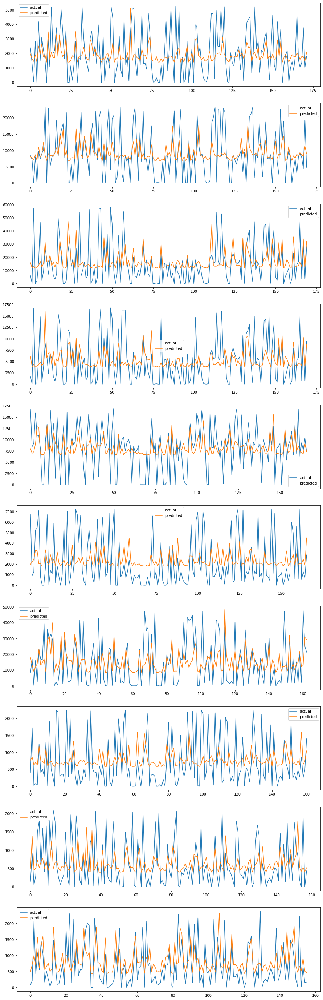

In [310]:
# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

# run OLS on each state
start_1 = time.time() # time how long it takes to find the models
for i in range(10):
  # create temporary dataset
  temp = DATA[DATA.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10].astype(np.float64)
  Y = temp[:, 5].astype(np.float64)

  startPCA = time.time()

  # Apply PCA to the data matrices
  X_pca_i = PCA(X, 0.8)

  endPCA = time.time()
  print('PCA took', endPCA-startPCA, 'seconds')

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X_pca_i, Y, test_size = 0.4, random_state = 0)

  # create model
  model = linear_model.LinearRegression(normalize = True)

  # fit model
  model.fit(trainX, trainY)

  # test model
  trainPred = model.predict(trainX)
  testPred = model.predict(testX)
  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('     ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end_1 = time.time()

It can be seen here that PCA also does not help with the predicitions at all. Thus overall, for this problem, PCA is not the tool that should be used for linear regression models.

We did attempt to use Gaussian kernel regression after using PCA on this data. However, we were unable to do so, because the data caused a singular matrix to form. This is likely due to repeating (or very close) values in the data.

### Data Truncation

Now, it can be seen that for all of the states that in the first 50 days of data collection, there is no increase from 0 deaths per day. Thus, if those first 50 days were removed, i.e. the data is truncated, then regression models may be able to make better predicitons about the data. 

Thus, the imported dataset is subsetted to not include those terms. Then, we will run OLS models on the overall dataset and the individual states to see if there is any improvement in error and prediction. 

First, we will truncate the data to remove the first 50 days of data.

In [311]:
# subset by excluding data_index values less than or equal to 50
DATA_tr = DATA[DATA.date_index > 50]
data_tr = DATA_tr.to_numpy()
data_tr = data_tr[:, 6:11].astype(np.float64)

Now, using this dataset, we will run an OLS on the overall dataset with the count per day data.

MAE-> train : 32.497, test : 35.102
R2-> train : 0.483, test : 0.471
OLS took 0.005197763442993164 seconds


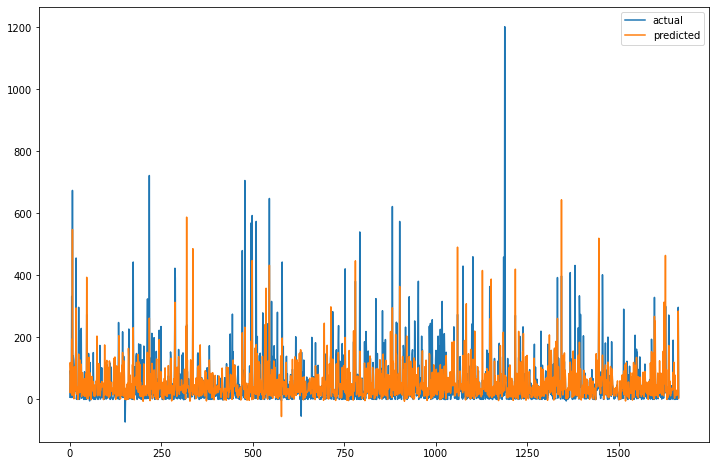

In [312]:
# split data into X and Y components
X_w_tr = data_tr[:, 0:4]
Y_w_tr = data_tr[:, 4]

start_1_tr = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w_tr, Y_w_tr, test_size = 0.4, random_state = 0)

# create model
model = linear_model.LinearRegression(normalize = True)

# fit model
model.fit(trainX, trainY)

# test model
trainPred = model.predict(trainX)
testPred = model.predict(testX)
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))

end_1_tr = time.time()
print('OLS took', end_1_tr - start_1_tr, 'seconds')

plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred, label="predicted")
plt.legend()
plt.show()

It can be seen here that the training and testing MAE value increased. However, it can also be seen that while the training $R^2$ value decreased, the testing $R^2$ value increased. 

Now we will also do this for each individual state. 

state index = 52
state = Washington
MAE-> train : 9.674, test : 11.097
R2-> train : 0.155, test : 0.073
     
state index = 15
state = Illinois
MAE-> train : 31.222, test : 35.939
R2-> train : 0.398, test : 0.399
     
state index = 5
state = California
MAE-> train : 87.834, test : 86.707
R2-> train : 0.405, test : 0.466
     
state index = 3
state = Arizona
MAE-> train : 31.655, test : 31.550
R2-> train : 0.285, test : 0.403
     
state index = 23
state = Massachusetts
MAE-> train : 26.773, test : 26.506
R2-> train : 0.325, test : 0.268
     
state index = 54
state = Wisconsin
MAE-> train : 11.060, test : 11.801
R2-> train : 0.537, test : 0.509
     
state index = 47
state = Texas
MAE-> train : 56.173, test : 56.090
R2-> train : 0.362, test : 0.576
     
state index = 29
state = Nebraska
MAE-> train : 3.598, test : 6.050
R2-> train : 0.457, test : 0.150
     
state index = 48
state = Utah
MAE-> train : 3.241, test : 3.057
R2-> train : 0.427, test : 0.519
     
state index = 40
state =

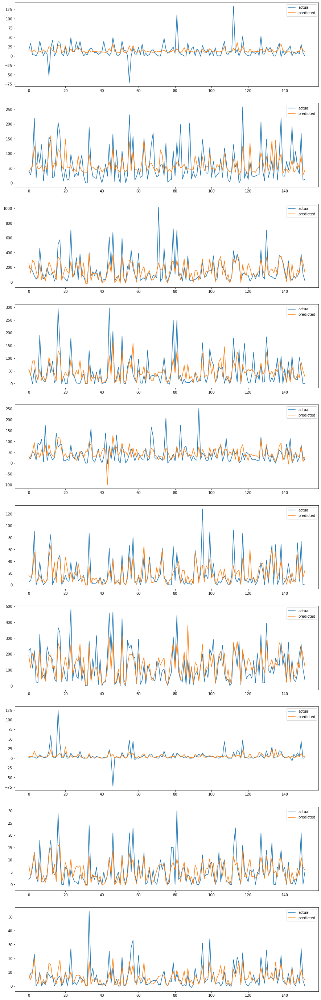

In [313]:
# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

# run OLS on each state
start_1_tr = time.time() # time how long it takes to find the models
for i in range(10):
  # create temporary dataset
  temp = DATA_tr[DATA_tr.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 10]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model = linear_model.LinearRegression(normalize = True)

  # fit model
  model.fit(trainX, trainY)

  # test model
  trainPred = model.predict(trainX)
  testPred = model.predict(testX)
  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('     ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end_1_tr = time.time()
print('Finding all of the OLS models took', end_1_tr - start_1_tr, 'seconds')

It can be seen that the only states that benefit from the truncation are Arizona and Wisconsin. This makes sense, since Arizona and Wisconsin have similar data structure, and both of them have a long inital period with no data. Thus, the data truncation for these states are helpful. 

However, the data truncation is not helpful for the rest of the states. More specifically, the data truncation increases the mean squared errors (MAEs) and decreases the $R^2$ values.

We will now repeat what was done above with the cumulative count data. We start with the overall data.

MAE-> train : 4544.012, test : 4601.567
R2-> train : 0.508, test : 0.518
OLS took 0.007195234298706055 seconds


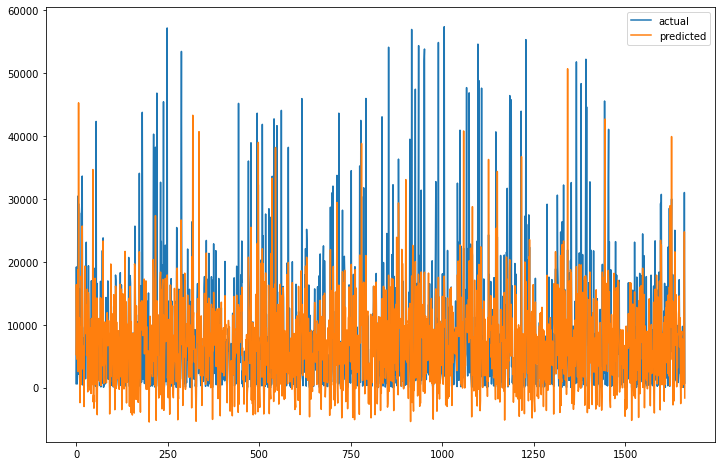

In [314]:
data_tr_c = DATA_tr.to_numpy()

# split data into X and Y components
X_w_tr = data_tr_c[:, 6:10]
Y_w_tr = data_tr_c[:, 5]

start_1_tr = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w_tr, Y_w_tr, test_size = 0.4, random_state = 0)

# create model
model = linear_model.LinearRegression(normalize = True)

# fit model
model.fit(trainX, trainY)

# test model
trainPred = model.predict(trainX)
testPred = model.predict(testX)
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))

end_1_tr = time.time()
print('OLS took', end_1_tr - start_1_tr, 'seconds')

plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred, label="predicted")
plt.legend()
plt.show()

Now we will do this for the individual states.

state index = 52
state = Washington
MAE-> train : 231.623, test : 229.516
R2-> train : 0.966, test : 0.961
     
state index = 15
state = Illinois
MAE-> train : 1127.323, test : 1212.781
R2-> train : 0.960, test : 0.951
     
state index = 5
state = California
MAE-> train : 4512.811, test : 4328.442
R2-> train : 0.897, test : 0.885
     
state index = 3
state = Arizona
MAE-> train : 1147.824, test : 1089.678
R2-> train : 0.926, test : 0.921
     
state index = 23
state = Massachusetts
MAE-> train : 915.562, test : 991.053
R2-> train : 0.935, test : 0.920
     
state index = 54
state = Wisconsin
MAE-> train : 657.268, test : 683.063
R2-> train : 0.904, test : 0.890
     
state index = 47
state = Texas
MAE-> train : 3170.189, test : 3103.484
R2-> train : 0.945, test : 0.937
     
state index = 29
state = Nebraska
MAE-> train : 206.017, test : 231.299
R2-> train : 0.905, test : 0.878
     
state index = 48
state = Utah
MAE-> train : 169.201, test : 174.349
R2-> train : 0.913, test : 0.898

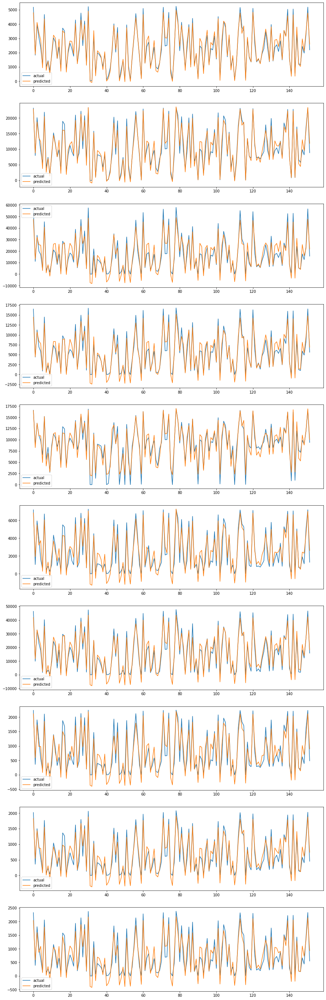

In [315]:
# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

# run OLS on each state
start_1_tr = time.time() # time how long it takes to find the models
for i in range(10):
  # create temporary dataset
  temp = DATA_tr[DATA_tr.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 5]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model = linear_model.LinearRegression(normalize = True)

  # fit model
  model.fit(trainX, trainY)

  # test model
  trainPred = model.predict(trainX)
  testPred = model.predict(testX)
  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('     ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end_1_tr = time.time()
print('Finding all of the OLS models took', end_1_tr - start_1_tr, 'seconds')

The data truncation does help for the states Washington, Arizona, Wisconsin, Texas, Nebraska and Oregon. It does not help much for the other states.

### Filtering Outliers in Count Per Day Data

We also want to investigate whether or not removing outliers will help with prediction. For several of the states, it can be seen that there are 1-2 spikes that are very different to the rest of the data. Thus, if those outlier points are filtered out of the dataset, then the predictions may be better. 

First, we subset the data to remove any data points that are outliers. We will do this individually for each state, some data points are considered outliers for some of the states and not all of them. 

We can see from the data visualization that the states Washington, California, Arizona, Texas and Nebraska have noticable outliers that could impact the model prediction. Those states will be filtered so that the outliers are removed. 


In [316]:
# subset by excluding data_index values that are outliers
# we first filter the outlier out of Washington
no_out_0 = DATA[DATA.state_index == unique_state_index_list[0]]
no_out_0 = no_out_0[no_out_0.d_per_day > -50].to_numpy()
no_out_2 = DATA[DATA.state_index == unique_state_index_list[2]]
no_out_2 = no_out_2[no_out_2.d_per_day < 800].to_numpy()
no_out_3 = DATA[DATA.state_index == unique_state_index_list[3]]
no_out_3 = no_out_3[no_out_3.d_per_day < 350].to_numpy()
no_out_6 = DATA[DATA.state_index == unique_state_index_list[6]]
no_out_6 = no_out_6[no_out_6.d_per_day < 600].to_numpy()
no_out_7 = DATA[DATA.state_index == unique_state_index_list[7]]
no_out_7 = no_out_7[no_out_7.d_per_day > -25]
no_out_7 = no_out_7[no_out_7.d_per_day < 100].to_numpy()

other_states = DATA[DATA.state_index != unique_state_index_list[0]]
other_states = other_states[other_states.state_index != unique_state_index_list[2]]
other_states = other_states[other_states.state_index != unique_state_index_list[3]]
other_states = other_states[other_states.state_index != unique_state_index_list[6]]
other_states = other_states[other_states.state_index != unique_state_index_list[7]]
other_states = other_states[other_states.state_index != unique_state_index_list[10]].to_numpy()

data_no_out = np.concatenate([no_out_0, no_out_2, no_out_3, no_out_6, no_out_7, other_states])
data_no_out = pd.DataFrame(data_no_out, columns = ['c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9', 'c10', 'c11'])

Now, with that data, we will run OLS models on the overall data and then on each state.

MAE-> train : 30.389, test : 28.581
R2-> train : 0.532, test : 0.554
OLS took 42.38833689689636 seconds


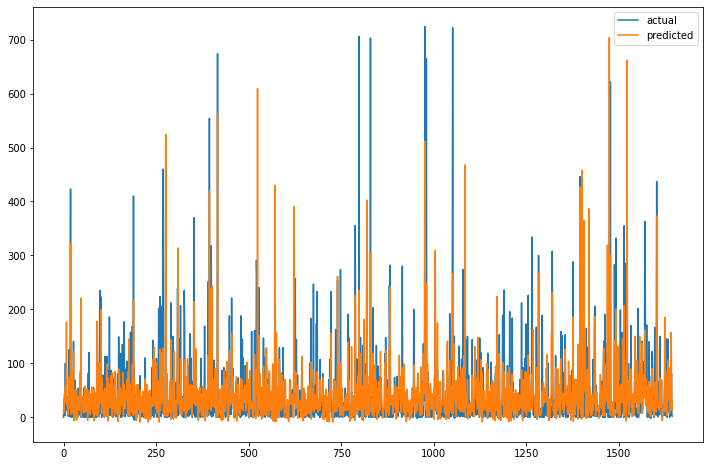

In [317]:
data_no_out_w = data_no_out.to_numpy()
data_no_out_w = data_no_out_w[:, 6:11].astype(np.float64)

# split data into X and Y components
X_n_out = data_no_out_w[:, 0:4]
Y_n_out = data_no_out_w[:, 4]

start_t = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_n_out, Y_n_out, test_size = 0.4, random_state = 0)

# create model
model = linear_model.LinearRegression(normalize = True)

# fit model
model.fit(trainX, trainY)

# test model
trainPred = model.predict(trainX)
testPred = model.predict(testX)
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))

end_1 = time.time()
print('OLS took', end_1 - start_1, 'seconds')

plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred, label="predicted")
plt.legend()
plt.show()

Now for each individual state.

state index = 52
state = Washington
MAE-> train : 8.481, test : 9.900
R2-> train : 0.268, test : 0.154
     
state index = 15
state = Illinois
MAE-> train : 33.189, test : 28.212
R2-> train : 0.434, test : 0.478
     
state index = 5
state = California
MAE-> train : 71.037, test : 75.511
R2-> train : 0.483, test : 0.542
     
state index = 3
state = Arizona
MAE-> train : 27.972, test : 29.056
R2-> train : 0.399, test : 0.279
     
state index = 23
state = Massachusetts
MAE-> train : 26.596, test : 26.416
R2-> train : 0.273, test : 0.229
     
state index = 54
state = Wisconsin
MAE-> train : 10.380, test : 10.817
R2-> train : 0.532, test : 0.572
     
state index = 47
state = Texas
MAE-> train : 50.849, test : 46.726
R2-> train : 0.595, test : 0.578
     
state index = 29
state = Nebraska
MAE-> train : 3.708, test : 4.155
R2-> train : 0.437, test : 0.375
     
state index = 48
state = Utah
MAE-> train : 3.160, test : 2.864
R2-> train : 0.466, test : 0.519
     
state index = 40
state = 

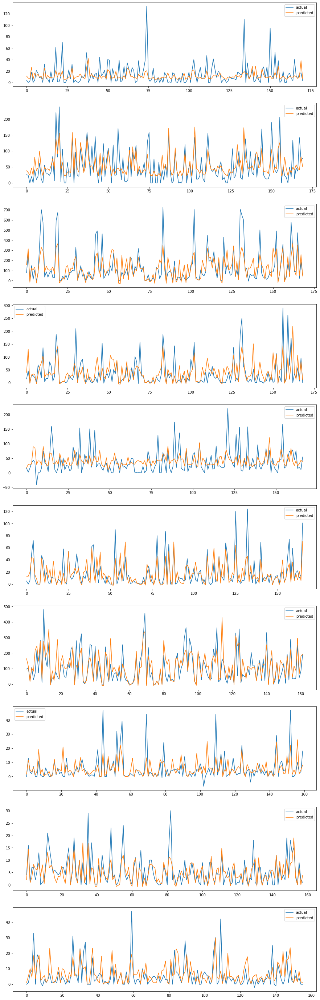

In [318]:
# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

# run OLS on each state
start_1 = time.time() # time how long it takes to find the models
for i in range(10):
  # create temporary dataset
  temp = data_no_out[data_no_out.c8 == unique_state_index_list[i]].to_numpy()
  
  # split data into X and Y components
  X = temp[:, 6:10].astype(np.float64)
  Y = temp[:, 10].astype(np.float64)

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model = linear_model.LinearRegression(normalize = True)

  # fit model
  model.fit(trainX, trainY)

  # test model
  trainPred = model.predict(trainX)
  testPred = model.predict(testX)
  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('     ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end_1 = time.time()
print('Finding all of the OLS models took', end_1 - start_1, 'seconds')

We can see here that all of the states, except for Arizona, have big improvements in the MAE values and the $R^2$ values. Thus, we want to remove the outliers for the state that it helped in. 

In [319]:
# subset by excluding data_index values that are outliers
# we first filter the outlier out of Washington
no_out_0 = DATA[DATA.state_index == unique_state_index_list[0]]
no_out_0 = no_out_0[no_out_0.d_per_day > -50].to_numpy()
no_out_2 = DATA[DATA.state_index == unique_state_index_list[2]]
no_out_2 = no_out_2[no_out_2.d_per_day < 800].to_numpy()
no_out_6 = DATA[DATA.state_index == unique_state_index_list[6]]
no_out_6 = no_out_6[no_out_6.d_per_day < 600].to_numpy()
no_out_7 = DATA[DATA.state_index == unique_state_index_list[7]]
no_out_7 = no_out_7[no_out_7.d_per_day > -25]
no_out_7 = no_out_7[no_out_7.d_per_day < 100].to_numpy()

other_states = DATA[DATA.state_index != unique_state_index_list[0]]
other_states = other_states[other_states.state_index != unique_state_index_list[2]]
other_states = other_states[other_states.state_index != unique_state_index_list[6]]
other_states = other_states[other_states.state_index != unique_state_index_list[7]]
other_states = other_states[other_states.state_index != unique_state_index_list[10]].to_numpy()

data_no_out = np.concatenate([no_out_0, no_out_2, no_out_3, no_out_6, no_out_7, other_states])

DATA.columns

DATA_fil = pd.DataFrame(data_no_out, columns = DATA.columns)

# Linear Regression Methods

Now, we will try to use other regression methods to see what effect they have on the errors and the predicitons of the overall dataset and of the individual state data. The types of models that will be used are listed below.
1. Ridge regression
2. LASSO regression
3. Elastic-net regression

### Ridge Regression

The first model that will be used is ridge regression. The main difference between ridge regression and normal linear regression is an additional term added into the loss function. Specifically, the loss function (below) differes from the linear regression model by the addition of an $L^2$ regularization penalty. 

$$L(\theta) = \|\theta_0 + X\theta - y\| + \lambda_2\|\theta\|^2$$

The effect of an L2 penalty is to avoid overfitting. However, if that $\lambda_2$ is too large, it leads to underfitting. 

First, we will run the models using the counts per day data.

We run ridge regression on the overall dataset. We set the hyperparameter here to 0.01, so that the effect of the regularization does not mute any of the parameters that are important. 

Ridge took 0.005232095718383789 seconds
MAE-> train : 32.252, test : 28.476
R2-> train : 0.506, test : 0.439


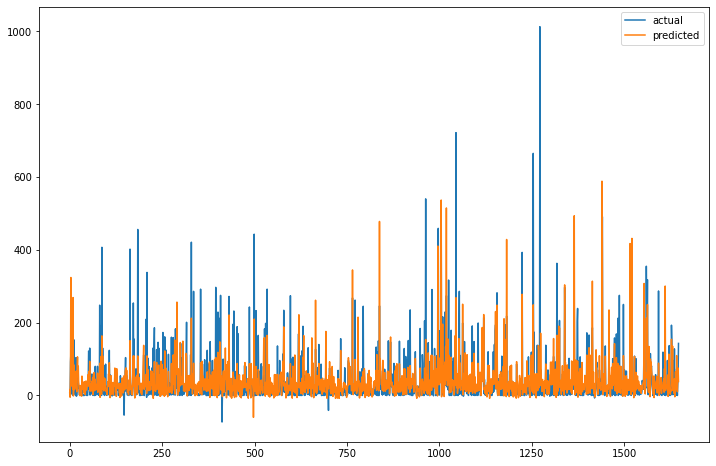

In [320]:
start_2_r = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w, test_size = 0.4, random_state = 0)

# create model
model_r = linear_model.Ridge(alpha = 0.01, normalize = True)

# fit model
model_r.fit(trainX, trainY)

end_2_r = time.time()
print('Ridge took', end_2_r - start_2_r, 'seconds')

# test model
trainPred2 = model_r.predict(trainX)
testPred2 = model_r.predict(testX)
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred2), mean_absolute_error(testY,testPred2)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred2), r2_score(testY,testPred2)))

plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred2, label="predicted")
plt.legend()
plt.show()

It can be seen that the results of using ridge regression here are very close to that of OLS, with small differences in testing mean squared error (MAE) and training $R^2$.

We now find the ridge regression models for each of the individual states.

state index = 52
state = Washington
MAE-> train : 8.481, test : 9.901
R2-> train : 0.268, test : 0.154
     
state index = 15
state = Illinois
MAE-> train : 33.195, test : 28.215
R2-> train : 0.434, test : 0.477
     
state index = 5
state = California
MAE-> train : 71.011, test : 75.489
R2-> train : 0.483, test : 0.542
     
state index = 3
state = Arizona
MAE-> train : 28.564, test : 27.362
R2-> train : 0.358, test : 0.381
     
state index = 23
state = Massachusetts
MAE-> train : 26.592, test : 26.417
R2-> train : 0.273, test : 0.229
     
state index = 54
state = Wisconsin
MAE-> train : 10.380, test : 10.817
R2-> train : 0.532, test : 0.572
     
state index = 47
state = Texas
MAE-> train : 50.854, test : 46.722
R2-> train : 0.595, test : 0.578
     
state index = 29
state = Nebraska
MAE-> train : 3.708, test : 4.155
R2-> train : 0.437, test : 0.375
     
state index = 48
state = Utah
MAE-> train : 3.159, test : 2.864
R2-> train : 0.466, test : 0.519
     
state index = 40
state = 

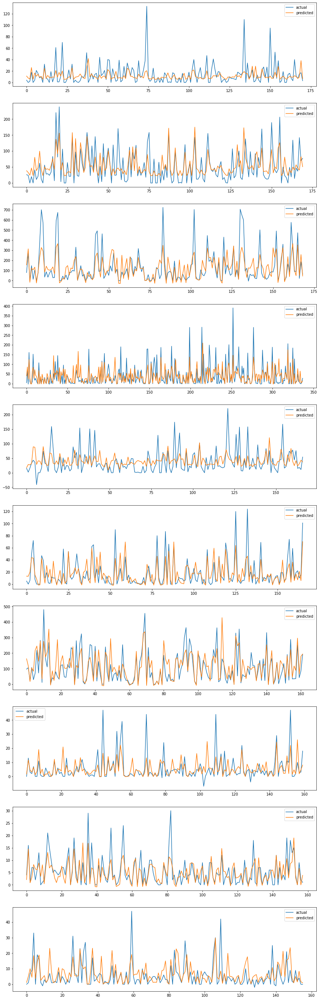

In [321]:
# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

# run ridge regression on each state
start_2_i = time.time() # time how long it takes to find the models
for i in range(10):
  # create temporary dataset
  temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 10]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model_r_i = linear_model.Ridge(alpha = 0.001, normalize = True)

  # fit model
  model_r_i.fit(trainX, trainY)

  # test model
  trainPred = model_r_i.predict(trainX)
  testPred = model_r_i.predict(testX)
  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('     ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end_2_i = time.time()
print('Finding all of the Ridge models took', end_2_i - start_2_i, 'seconds')

It can be seen for these results, the values are similar to that of OLS.

Now we will run the models for the cumulative count data.

Ridge took 0.004959821701049805 seconds
MAE-> train : 4339.901, test : 4090.624
R2-> train : 0.496, test : 0.477


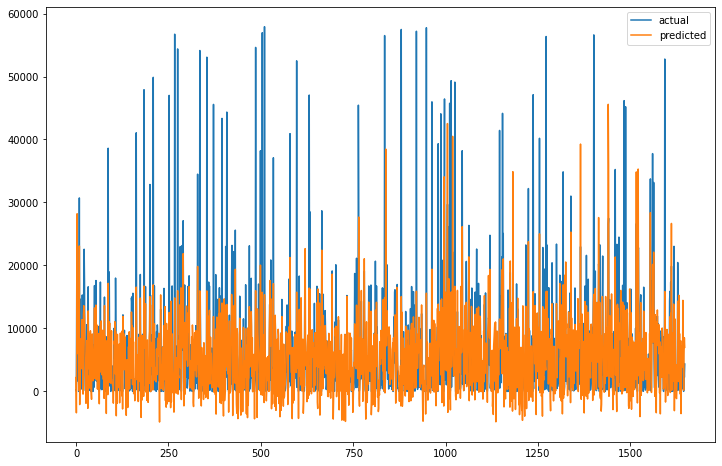

In [322]:
start_2_r = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w_c, test_size = 0.4, random_state = 0)

# create model
model_r = linear_model.Ridge(alpha = 0.01, normalize = True)

# fit model
model_r.fit(trainX, trainY)

end_2_r = time.time()
print('Ridge took', end_2_r - start_2_r, 'seconds')

# test model
trainPred2 = model_r.predict(trainX)
testPred2 = model_r.predict(testX)
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred2), mean_absolute_error(testY,testPred2)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred2), r2_score(testY,testPred2)))

plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred2, label="predicted")
plt.legend()
plt.show()

Now we will run the model using the individual states and the cumulative count data.

state index = 52
state = Washington
MAE-> train : 238.115, test : 230.557
R2-> train : 0.964, test : 0.966
     
state index = 15
state = Illinois
MAE-> train : 1224.768, test : 1307.486
R2-> train : 0.958, test : 0.953
     
state index = 5
state = California
MAE-> train : 4979.625, test : 4920.707
R2-> train : 0.870, test : 0.861
     
state index = 3
state = Arizona
MAE-> train : 1394.902, test : 1339.335
R2-> train : 0.900, test : 0.901
     
state index = 23
state = Massachusetts
MAE-> train : 904.211, test : 957.932
R2-> train : 0.948, test : 0.943
     
state index = 54
state = Wisconsin
MAE-> train : 740.883, test : 731.369
R2-> train : 0.878, test : 0.872
     
state index = 47
state = Texas
MAE-> train : 3584.424, test : 3789.486
R2-> train : 0.925, test : 0.918
     
state index = 29
state = Nebraska
MAE-> train : 225.203, test : 234.058
R2-> train : 0.891, test : 0.866
     
state index = 48
state = Utah
MAE-> train : 183.412, test : 179.699
R2-> train : 0.894, test : 0.901

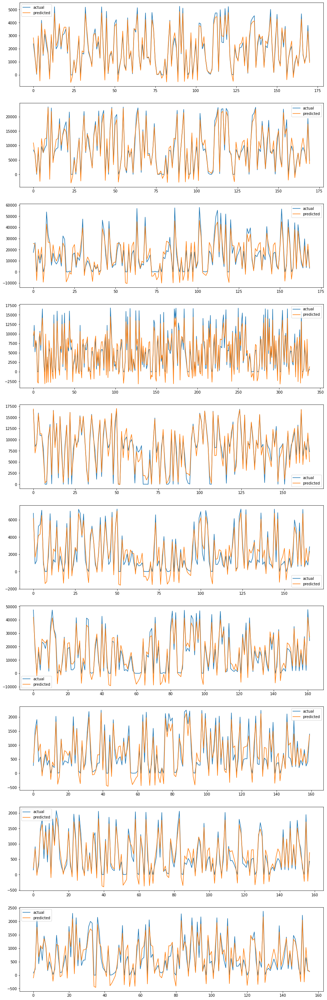

In [323]:
# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

# run ridge regression on each state
start_2_i = time.time() # time how long it takes to find the models
for i in range(10):
  # create temporary dataset
  temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 5]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model_r_i = linear_model.Ridge(alpha = 0.001, normalize = True)

  # fit model
  model_r_i.fit(trainX, trainY)

  # test model
  trainPred = model_r_i.predict(trainX)
  testPred = model_r_i.predict(testX)
  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('     ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end_2_i = time.time()
print('Finding all of the Ridge models took', end_2_i - start_2_i, 'seconds')

### LASSO Regression

The next regression model that will be used is LASSO regression. This is similar to ridge regression, but it adds a different kind of term to the loss function. The loss function (below) differes from the linear regression model and the ridge regression model by the addition of an $L^1$ regularization penalty, instead of an $L^2$ penalty. 

$$L(\theta) = \|\theta_0 + X\theta - y\| + \lambda_1\|\theta\|$$

The effect of the $L^1$ penalty is that it shrinks the coefficients of any unneeded paramaters in the model towards zero. However, with a large $\lambda_1$ value, the model will underfit because the parameters have gone towards zero.

First, we will run the models on the count per day data.

We run LASSO regression on the overall dataset initally. We set the hyperparameter here to 0.01, so that the effect of the regularization does not remove any parameters when they should not be removed.

LASSO took 0.012307882308959961 seconds
MAE-> train : 32.142, test : 28.393
R2-> train : 0.506, test : 0.438


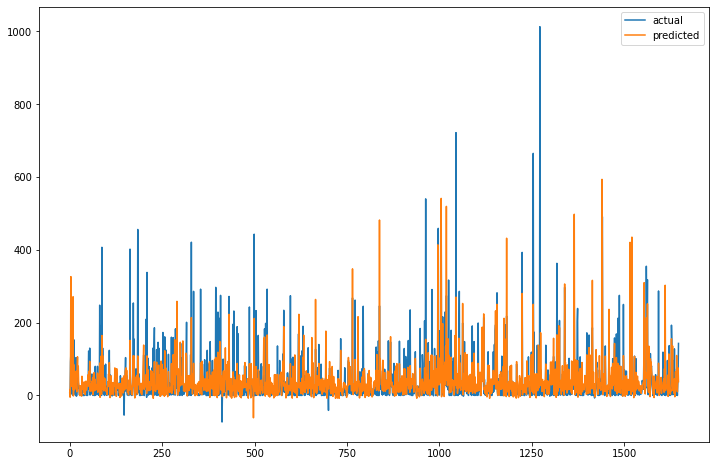

In [324]:
start_2_l = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w, test_size = 0.4, random_state = 0)

# create model
model_l = linear_model.Lasso(alpha = 0.001, normalize = True)

# fit model
model_l.fit(trainX, trainY)

end_2_l = time.time()
print('LASSO took', end_2_l - start_2_l, 'seconds')

# test model
trainPred2 = model_l.predict(trainX)
testPred2 = model_l.predict(testX)
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred2), mean_absolute_error(testY,testPred2)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred2), r2_score(testY,testPred2)))

plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred2, label="predicted")
plt.legend()
plt.show()

The results of the LASSO regression has similar results to ridge regression.

We now run LASSO regression on each of the individual states. We keep the hyperparameter as the same as before.

state index = 52
state = Washington
MAE-> train : 8.482, test : 9.904
R2-> train : 0.268, test : 0.153
     
state index = 15
state = Illinois
MAE-> train : 33.190, test : 28.211
R2-> train : 0.434, test : 0.478
     
state index = 5
state = California
MAE-> train : 71.032, test : 75.508
R2-> train : 0.483, test : 0.542
     
state index = 3
state = Arizona
MAE-> train : 28.563, test : 27.361
R2-> train : 0.358, test : 0.381
     
state index = 23
state = Massachusetts
MAE-> train : 26.592, test : 26.416
R2-> train : 0.273, test : 0.229
     
state index = 54
state = Wisconsin
MAE-> train : 10.375, test : 10.813
R2-> train : 0.532, test : 0.572
     
state index = 47
state = Texas
MAE-> train : 50.850, test : 46.725
R2-> train : 0.595, test : 0.578
     
state index = 29
state = Nebraska
MAE-> train : 3.706, test : 4.152
R2-> train : 0.437, test : 0.375
     
state index = 48
state = Utah
MAE-> train : 3.157, test : 2.860
R2-> train : 0.466, test : 0.519
     
state index = 40
state = 

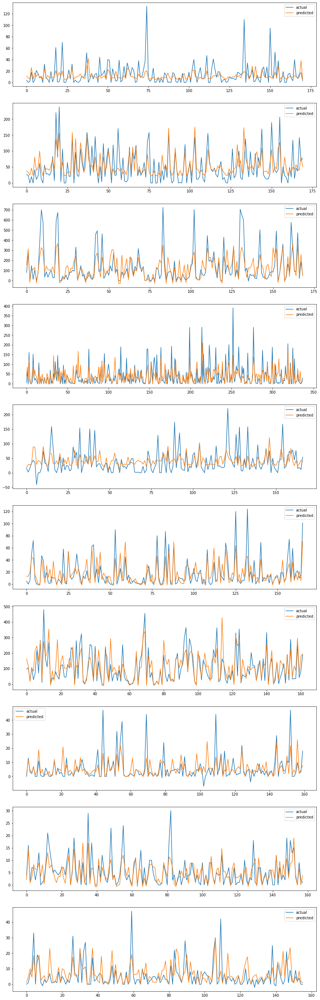

In [325]:
# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

# run ridge regression on each state
start_2_i = time.time() # time how long it takes to find the models
for i in range(10):
  # create temporary dataset
  temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 10]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model_l_i = linear_model.Lasso(alpha = 0.001, normalize = True)

  # fit model
  model_l_i.fit(trainX, trainY)

  # test model
  trainPred = model_l_i.predict(trainX)
  testPred = model_l_i.predict(testX)
  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('     ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end_2_i = time.time()
print('Finding all of the LASSO models took', end_2_i - start_2_i, 'seconds')

The results of the LASSO regression has similar results to ridge regression.

Now we will use the cumulative count data for the models.

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30974442587.55089, tolerance: 22853393.781551413
  positive)


LASSO took 0.02449631690979004 seconds
MAE-> train : 4344.714, test : 4093.222
R2-> train : 0.496, test : 0.478


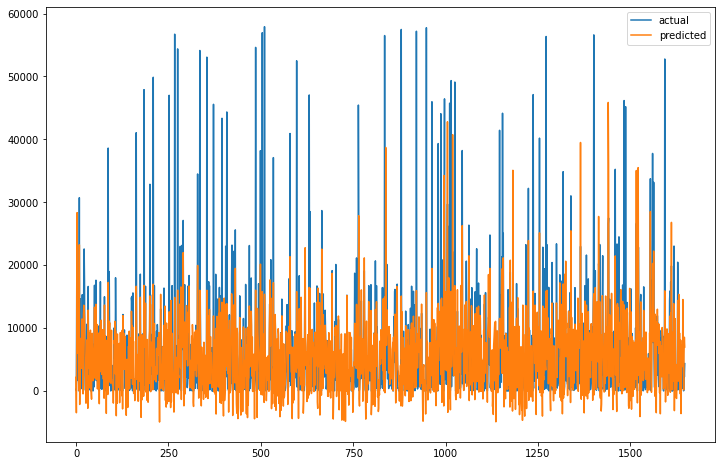

In [326]:
start_2_l = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w_c, test_size = 0.4, random_state = 0)

# create model
model_l = linear_model.Lasso(alpha = 0.001, normalize = True)

# fit model
model_l.fit(trainX, trainY)

end_2_l = time.time()
print('LASSO took', end_2_l - start_2_l, 'seconds')

# test model
trainPred2 = model_l.predict(trainX)
testPred2 = model_l.predict(testX)
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred2), mean_absolute_error(testY,testPred2)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred2), r2_score(testY,testPred2)))

plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred2, label="predicted")
plt.legend()
plt.show()

Now we will do the same for the individual state data.

state index = 52
state = Washington
MAE-> train : 238.297, test : 230.585
R2-> train : 0.964, test : 0.966
     
state index = 15
state = Illinois
MAE-> train : 1223.537, test : 1306.163
R2-> train : 0.958, test : 0.953
     
state index = 5
state = California
MAE-> train : 4981.376, test : 4923.949
R2-> train : 0.870, test : 0.861
     
state index = 3
state = Arizona
MAE-> train : 1394.746, test : 1339.842
R2-> train : 0.900, test : 0.900
     
state index = 23
state = Massachusetts
MAE-> train : 904.045, test : 957.755
R2-> train : 0.948, test : 0.943
     
state index = 54
state = Wisconsin
MAE-> train : 740.516, test : 731.062
R2-> train : 0.878, test : 0.871
     
state index = 47
state = Texas
MAE-> train : 3584.293, test : 3789.897
R2-> train : 0.925, test : 0.918
     
state index = 29
state = Nebraska
MAE-> train : 225.125, test : 234.064
R2-> train : 0.891, test : 0.866
     
state index = 48
state = Utah
MAE-> train : 183.352, test : 179.641
R2-> train : 0.894, test : 0.901

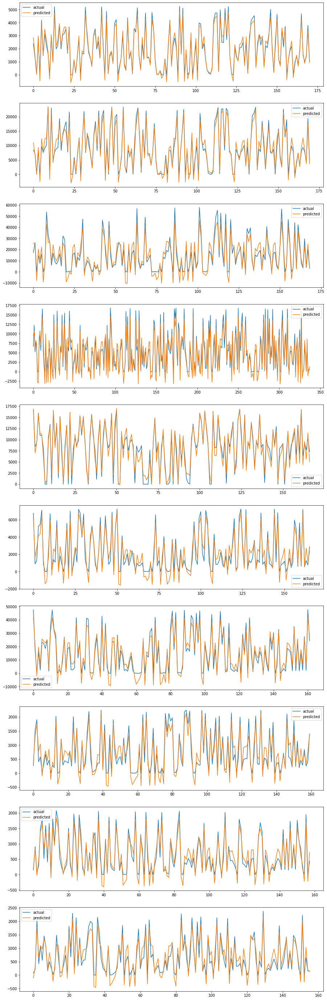

In [327]:
# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

# run ridge regression on each state
start_2_i = time.time() # time how long it takes to find the models
for i in range(10):
  # create temporary dataset
  temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 5]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model_l_i = linear_model.Lasso(alpha = 0.001, normalize = True)

  # fit model
  model_l_i.fit(trainX, trainY)

  # test model
  trainPred = model_l_i.predict(trainX)
  testPred = model_l_i.predict(testX)
  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('     ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end_2_i = time.time()
print('Finding all of the LASSO models took', end_2_i - start_2_i, 'seconds')

### Elastic-net Regression

The final regression model that will be used is elastic-net regression. Specifically, the loss function (below) has both $L^1$ and $L^2$ regularization penalties. 

$$L(\theta) = \|\theta_0 + X\theta - y\| + + \lambda_2\|\theta\|^2 + \lambda_1\|\theta\|$$



Following the same pattern as beforehand, we will first use the count per day data and then the cumulative count data.

We use elastic-net regression on the overall dataset.

Elastic-net took 0.007974386215209961 seconds
MAE-> train : 33.369, test : 29.324
R2-> train : 0.501, test : 0.445


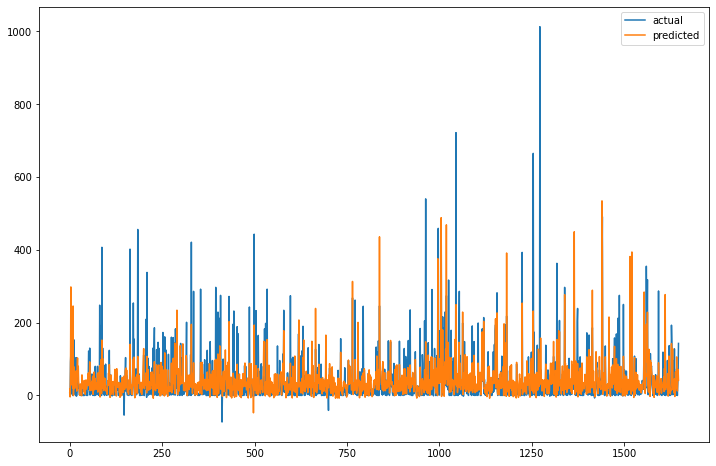

In [328]:
start_2 = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w, test_size = 0.4, random_state = 0)

# create model
model2 = linear_model.ElasticNet(alpha = 0.0001, l1_ratio = 0.5, normalize = True)

# fit model
model2.fit(trainX, trainY)

end_2 = time.time()
print('Elastic-net took', end_2 - start_2, 'seconds')

# test model
trainPred2 = model2.predict(trainX)
testPred2 = model2.predict(testX)
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred2), mean_absolute_error(testY,testPred2)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred2), r2_score(testY,testPred2)))

plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred2, label="predicted")
plt.legend()
plt.show()

The results for the elastic-net regression are more different than the results of all of the previously used models. There is better testing values of $R^2$ here, but a slightly larger amount of MAE.

Now, find the models for each of the states.

state index = 52
state = Washington
MAE-> train : 8.485, test : 9.912
R2-> train : 0.268, test : 0.154
     
state index = 15
state = Illinois
MAE-> train : 33.267, test : 28.252
R2-> train : 0.434, test : 0.477
     
state index = 5
state = California
MAE-> train : 70.724, test : 75.261
R2-> train : 0.483, test : 0.541
     
state index = 3
state = Arizona
MAE-> train : 28.620, test : 27.419
R2-> train : 0.358, test : 0.381
     
state index = 23
state = Massachusetts
MAE-> train : 26.549, test : 26.425
R2-> train : 0.273, test : 0.229
     
state index = 54
state = Wisconsin
MAE-> train : 10.382, test : 10.810
R2-> train : 0.532, test : 0.572
     
state index = 47
state = Texas
MAE-> train : 50.915, test : 46.676
R2-> train : 0.595, test : 0.579
     
state index = 29
state = Nebraska
MAE-> train : 3.710, test : 4.154
R2-> train : 0.437, test : 0.375
     
state index = 48
state = Utah
MAE-> train : 3.157, test : 2.860
R2-> train : 0.466, test : 0.518
     
state index = 40
state = 

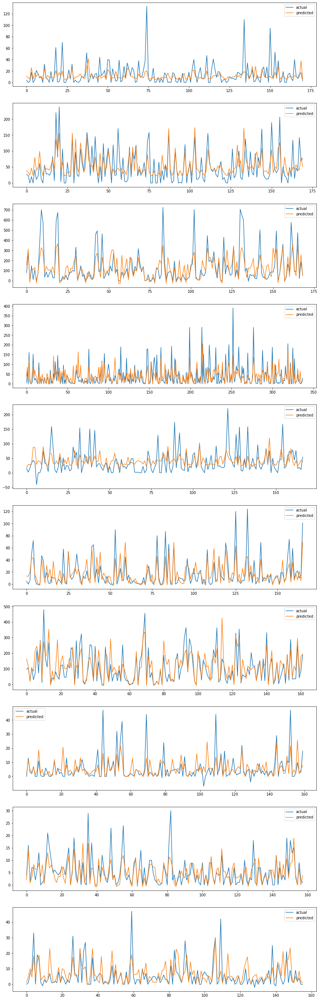

In [329]:
# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

# run OLS on each state
start_2 = time.time() # time how long it takes to find the models
for i in range(10):
  # create temporary dataset
  temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 10]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model2i = linear_model.ElasticNet(alpha = 0.0001, l1_ratio = 0.5, normalize = True)

  # fit model
  model2i.fit(trainX, trainY)

  # test model
  trainPred = model2i.predict(trainX)
  testPred = model2i.predict(testX)
  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('     ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end_2 = time.time()
print('Finding all of the elastic-net models took', end_2 - start_2, 'seconds')

It can be seen that the results here for elastic-net regression are close to the previous results of the other models. 

We will now repeat this with the cumulative count data, using the overall dataset first.

Elastic-net took 0.007053852081298828 seconds
MAE-> train : 4281.119, test : 4055.988
R2-> train : 0.492, test : 0.472


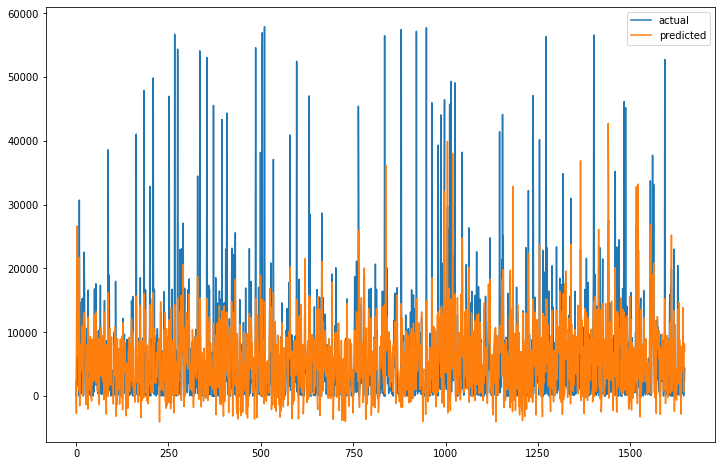

In [330]:
start_2 = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w_c, test_size = 0.4, random_state = 0)

# create model
model2 = linear_model.ElasticNet(alpha = 0.0001, l1_ratio = 0.5, normalize = True)

# fit model
model2.fit(trainX, trainY)

end_2 = time.time()
print('Elastic-net took', end_2 - start_2, 'seconds')

# test model
trainPred2 = model2.predict(trainX)
testPred2 = model2.predict(testX)
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred2), mean_absolute_error(testY,testPred2)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred2), r2_score(testY,testPred2)))

plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred2, label="predicted")
plt.legend()
plt.show()

Now we will repeat this with the individual state data.

state index = 52
state = Washington
MAE-> train : 236.479, test : 230.526
R2-> train : 0.964, test : 0.966
     
state index = 15
state = Illinois
MAE-> train : 1241.718, test : 1323.786
R2-> train : 0.957, test : 0.953
     
state index = 5
state = California
MAE-> train : 4960.456, test : 4887.143
R2-> train : 0.870, test : 0.862
     
state index = 3
state = Arizona
MAE-> train : 1399.454, test : 1330.546
R2-> train : 0.899, test : 0.901
     
state index = 23
state = Massachusetts
MAE-> train : 911.327, test : 968.073
R2-> train : 0.948, test : 0.943
     
state index = 54
state = Wisconsin
MAE-> train : 745.009, test : 734.861
R2-> train : 0.878, test : 0.871
     
state index = 47
state = Texas
MAE-> train : 3585.889, test : 3787.776
R2-> train : 0.925, test : 0.918
     
state index = 29
state = Nebraska
MAE-> train : 226.115, test : 234.019
R2-> train : 0.891, test : 0.867
     
state index = 48
state = Utah
MAE-> train : 184.067, test : 180.342
R2-> train : 0.894, test : 0.900

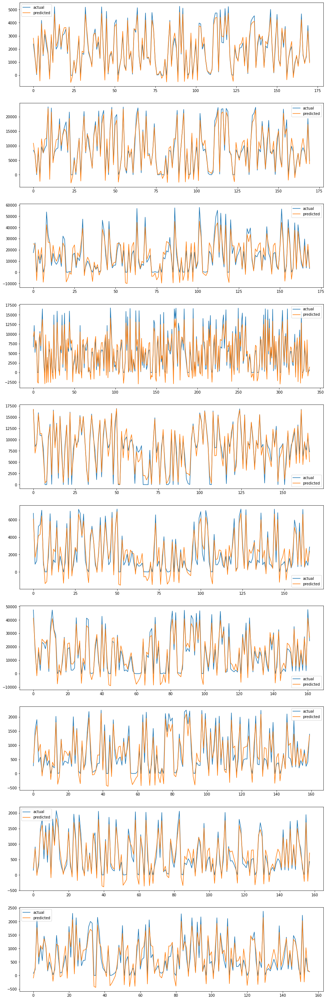

In [331]:
# allow for multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

# run OLS on each state
start_2 = time.time() # time how long it takes to find the models
for i in range(10):
  # create temporary dataset
  temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 5]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model2i = linear_model.ElasticNet(alpha = 0.0001, l1_ratio = 0.5, normalize = True)

  # fit model
  model2i.fit(trainX, trainY)

  # test model
  trainPred = model2i.predict(trainX)
  testPred = model2i.predict(testX)
  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('     ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end_2 = time.time()
print('Finding all of the elastic-net models took', end_2 - start_2, 'seconds')

# Hyperparameter Tuning

Now that the models have been run intially, we will now tune the hyperparameters of each of the models. The goal of tuning is to find the values of the hyperparameters that give the best values for the error and predicitions. 

Each of the models will be tuned using a cross-validation method found in the 'sklearn' Python package. For example, we will use the class "ElasticNetCV" from the 'sklearn' package to tune the elastic-net regression models. Here, we will find the best hyperparameters of the elastic-net model by inputting lists of $\alpha$ values and L1-ratio values.

### Ridge Regression Tuning

The first model we will tune is the ridge regression, where we will tune the $\alpha$ parameter. 

First, we will tune the models using the count per day data, and then with cumulative count data.

We tune the hyperparameters of the model first using the overall dataset. Using that $\alpha$ we wil find the training and testing MAE and $R^2$ scores to save.

Tuning the ridge model took 0.006426811218261719 seconds
MAE-> train : 32.109, test : 28.365
R2-> train : 0.507, test : 0.438
alpha: 0.001


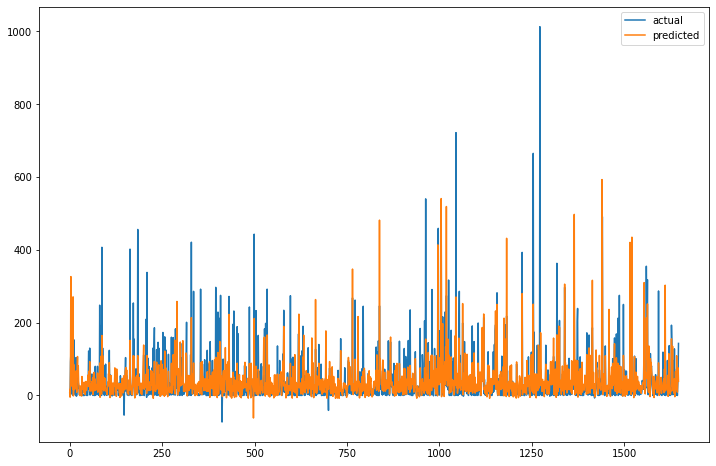

In [332]:
alphaValues = np.linspace(0.001, 0.1, 20)

start_r_t = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w, test_size = 0.4, random_state = 0)

# create model
model2 = linear_model.RidgeCV(alphas = alphaValues, normalize = True)
model2.fit(trainX, trainY)

end_r_t = time.time()
print('Tuning the ridge model took', end_r_t - start_r_t, 'seconds')

trainPred = model2.predict(trainX)
testPred = model2.predict(testX)
train_MAE_overall.append(mean_absolute_error(trainY,trainPred))
test_MAE_overall.append(mean_absolute_error(testY,testPred))
train_R2_overall.append(r2_score(trainY,trainPred))
test_R2_overall.append(r2_score(testY,testPred))
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))

# save best alpha
print('alpha:', model2.alpha_)
alphaO_ridge = model2.alpha_

# plot model
plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred, label="predicted")
plt.legend()

We find that the optimal value of $\alpha$ for both the training and testing predicitions is 0.005. 

Now, we will tune the hyperparameter of the model with the individual models.

state index = 52
state = Washington
alpha: 0.09563157894736843
MAE-> train : 8.518, test : 9.980
R2-> train : 0.266, test : 0.151
    
state index = 15
state = Illinois
alpha: 0.048315789473684215
MAE-> train : 33.496, test : 28.369
R2-> train : 0.433, test : 0.475
    
state index = 5
state = California
alpha: 0.048315789473684215
MAE-> train : 70.024, test : 74.734
R2-> train : 0.482, test : 0.538
    
state index = 3
state = Arizona
alpha: 0.048315789473684215
MAE-> train : 28.679, test : 27.481
R2-> train : 0.357, test : 0.381
    
state index = 23
state = Massachusetts
alpha: 0.048315789473684215
MAE-> train : 26.473, test : 26.492
R2-> train : 0.271, test : 0.226
    
state index = 54
state = Wisconsin
alpha: 0.001
MAE-> train : 10.380, test : 10.817
R2-> train : 0.532, test : 0.572
    
state index = 47
state = Texas
alpha: 0.19026315789473686
MAE-> train : 53.152, test : 47.633
R2-> train : 0.588, test : 0.586
    
state index = 29
state = Nebraska
alpha: 0.048315789473684215
M

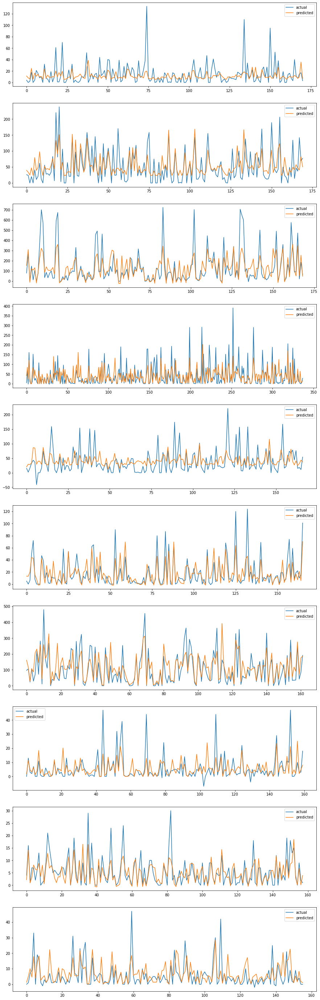

In [333]:
alphaValues = np.linspace(0.001, 0.9, 20)

alphas_O_ridge = []

start = time.time() # time how long it takes to find the model

# allow multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

for i in range(10):
  # create temporary dataset
  temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 10]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model_r_i = linear_model.RidgeCV(alphas = alphaValues, normalize = True)
  model_r_i.fit(trainX, trainY)

  trainPred = model_r_i.predict(trainX)
  testPred = model_r_i.predict(testX)

  train_MAE_indiv[i].append(mean_absolute_error(trainY,trainPred))
  test_MAE_indiv[i].append(mean_absolute_error(testY,testPred))
  train_R2_indiv[i].append(r2_score(trainY,trainPred))
  test_R2_indiv[i].append(r2_score(testY,testPred))

  alphas_O_ridge.append(model_r_i.alpha_)

  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('alpha:', model_r_i.alpha_)
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('    ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end = time.time()
print('Tuning the ridge models took', end - start, 'seconds')

Now we will repeat this for the cumulative count data.

Tuning the ridge model took 0.006276130676269531 seconds
MAE-> train : 4338.874, test : 4089.935
R2-> train : 0.496, test : 0.477
alpha: 0.011421052631578946


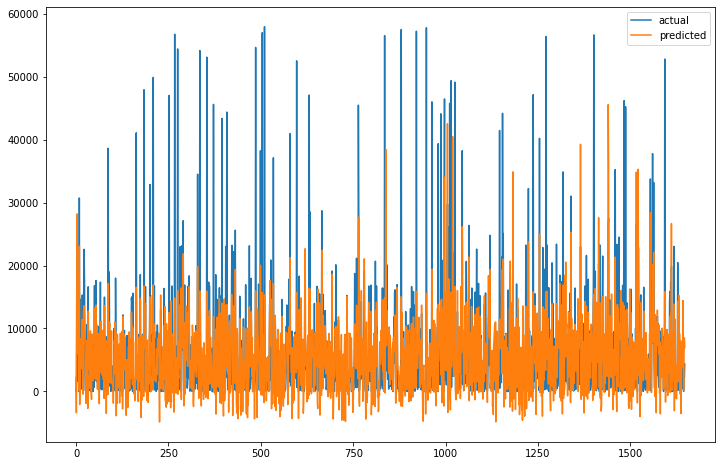

In [334]:
alphaValues = np.linspace(0.001, 0.1, 20)

start_r_t = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w_c, test_size = 0.4, random_state = 0)

# create model
model2 = linear_model.RidgeCV(alphas = alphaValues, normalize = True)
model2.fit(trainX, trainY)

end_r_t = time.time()
print('Tuning the ridge model took', end_r_t - start_r_t, 'seconds')

trainPred = model2.predict(trainX)
testPred = model2.predict(testX)
train_MAE_overall_c.append(mean_absolute_error(trainY,trainPred))
test_MAE_overall_c.append(mean_absolute_error(testY,testPred))
train_R2_overall_c.append(r2_score(trainY,trainPred))
test_R2_overall_c.append(r2_score(testY,testPred))
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))

# save best alpha
print('alpha:', model2.alpha_)
alphaO_c_ridge = model2.alpha_

# plot model
plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred, label="predicted")
plt.legend()

Now we will repeat this with the individual datasets.

state index = 52
state = Washington
alpha: 0.001
MAE-> train : 238.115, test : 230.557
R2-> train : 0.964, test : 0.966
    
state index = 15
state = Illinois
alpha: 0.001
MAE-> train : 1224.768, test : 1307.486
R2-> train : 0.958, test : 0.953
    
state index = 5
state = California
alpha: 0.001
MAE-> train : 4979.625, test : 4920.707
R2-> train : 0.870, test : 0.861
    
state index = 3
state = Arizona
alpha: 0.001
MAE-> train : 1394.902, test : 1339.335
R2-> train : 0.900, test : 0.901
    
state index = 23
state = Massachusetts
alpha: 0.001
MAE-> train : 904.211, test : 957.932
R2-> train : 0.948, test : 0.943
    
state index = 54
state = Wisconsin
alpha: 0.001
MAE-> train : 740.883, test : 731.369
R2-> train : 0.878, test : 0.872
    
state index = 47
state = Texas
alpha: 0.001
MAE-> train : 3584.424, test : 3789.486
R2-> train : 0.925, test : 0.918
    
state index = 29
state = Nebraska
alpha: 0.001
MAE-> train : 225.203, test : 234.058
R2-> train : 0.891, test : 0.866
    
stat

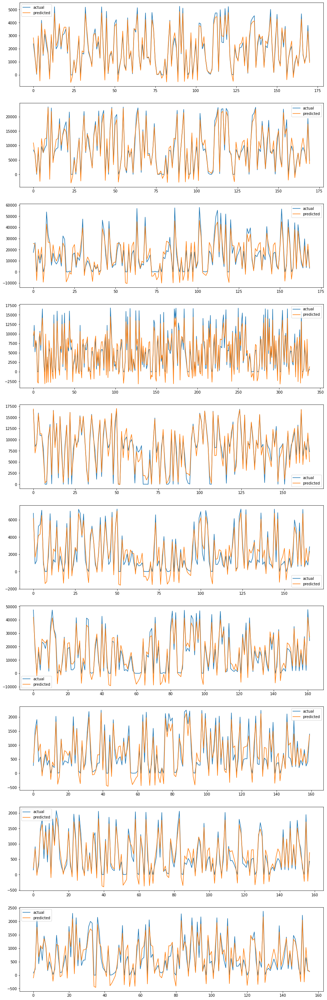

In [336]:
alphaValues = np.linspace(0.001, 0.9, 20)

alpha_O_c_ridge = []

start = time.time() # time how long it takes to find the model

# allow multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

for i in range(10):
  # create temporary dataset
  temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 5]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model_r_i = linear_model.RidgeCV(alphas = alphaValues, normalize = True)
  model_r_i.fit(trainX, trainY)

  trainPred = model_r_i.predict(trainX)
  testPred = model_r_i.predict(testX)

  train_MAE_indiv_c[i].append(mean_absolute_error(trainY,trainPred))
  test_MAE_indiv_c[i].append(mean_absolute_error(testY,testPred))
  train_R2_indiv_c[i].append(r2_score(trainY,trainPred))
  test_R2_indiv_c[i].append(r2_score(testY,testPred))

  alpha_O_c_ridge.append(model_r_i.alpha_)

  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('alpha:', model_r_i.alpha_)
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('    ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end = time.time()
print('Tuning the ridge models took', end - start, 'seconds')

### LASSO Regression Tuning

Now, we will tune is the LASSO regression, where we will tune the $\alpha$ parameter. We first will use the count per day data, and then the cumulative count data.

We tune the hyperparameters of the model first using the overall dataset.

Tuning the LASSO model took 0.10560393333435059 seconds
MAE-> train : 32.141, test : 28.390
R2-> train : 0.506, test : 0.438
alpha: 0.0013181938108176828


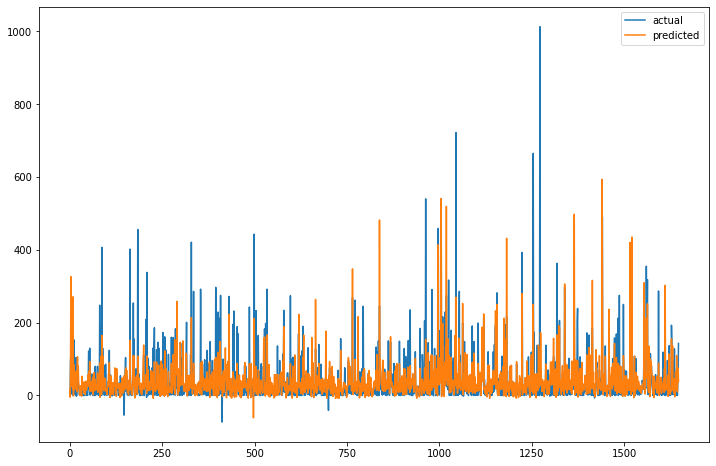

In [337]:
start_l_t = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w, test_size = 0.4, random_state = 0)

# create model
model2 = linear_model.LassoCV(normalize = True)
model2.fit(trainX, trainY)

end_l_t = time.time()
print('Tuning the LASSO model took', end_l_t - start_l_t, 'seconds')

trainPred = model2.predict(trainX)
testPred = model2.predict(testX)
train_MAE_overall.append(mean_absolute_error(trainY,trainPred))
test_MAE_overall.append(mean_absolute_error(testY,testPred))
train_R2_overall.append(r2_score(trainY,trainPred))
test_R2_overall.append(r2_score(testY,testPred))
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))

# store best alpha
print('alpha:', model2.alpha_)
alphaO_lasso = model2.alpha_

# plot model
plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred, label="predicted")
plt.legend()

Now, we will tune the hyperparameter of the model with the individual models.

state index = 52
state = Washington
alpha: 0.0098584481860566
MAE-> train : 8.491, test : 9.937
R2-> train : 0.268, test : 0.151
    
state index = 15
state = Illinois
alpha: 0.11094822674338317
MAE-> train : 33.510, test : 28.412
R2-> train : 0.433, test : 0.475
    
state index = 5
state = California
alpha: 0.0692218659353902
MAE-> train : 70.679, test : 75.335
R2-> train : 0.483, test : 0.539
    
state index = 3
state = Arizona
alpha: 0.03333478464195624
MAE-> train : 28.618, test : 27.424
R2-> train : 0.358, test : 0.381
    
state index = 23
state = Massachusetts
alpha: 0.034058639575938625
MAE-> train : 26.479, test : 26.417
R2-> train : 0.272, test : 0.228
    
state index = 54
state = Wisconsin
alpha: 0.0011092710934663035
MAE-> train : 10.375, test : 10.812
R2-> train : 0.532, test : 0.572
    
state index = 47
state = Texas
alpha: 0.3196897284160781
MAE-> train : 51.883, test : 46.853
R2-> train : 0.593, test : 0.584
    
state index = 29
state = Nebraska
alpha: 0.0005067218

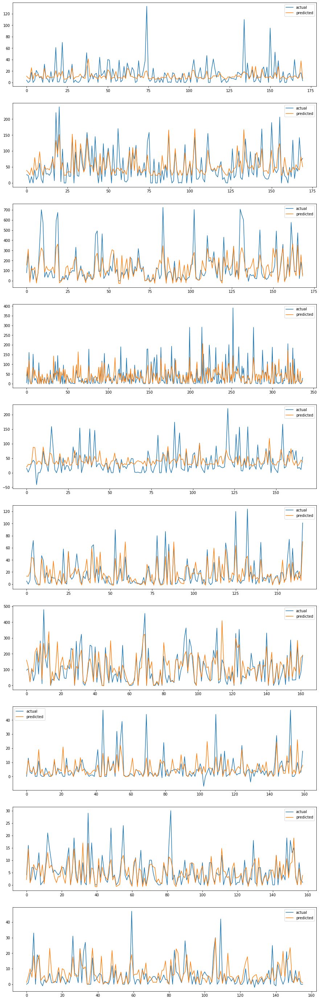

In [338]:
alpha_O_lasso = []

start = time.time() # time how long it takes to find the model

# allow multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

for i in range(10):
  # create temporary dataset
  temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 10]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model_l_i = linear_model.LassoCV(normalize = True)
  model_l_i.fit(trainX, trainY)

  trainPred = model_l_i.predict(trainX)
  testPred = model_l_i.predict(testX)

  train_MAE_indiv[i].append(mean_absolute_error(trainY,trainPred))
  test_MAE_indiv[i].append(mean_absolute_error(testY,testPred))
  train_R2_indiv[i].append(r2_score(trainY,trainPred))
  test_R2_indiv[i].append(r2_score(testY,testPred))

  alpha_O_lasso.append(model_r_i.alpha_)

  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('alpha:', model_l_i.alpha_)
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('    ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end = time.time()
print('Tuning the LASSO models took', end - start, 'seconds')

Now we will repeat the process with the cumulative count data.

Tuning the LASSO model took 0.11127829551696777 seconds
MAE-> train : 4342.171, test : 4090.949
R2-> train : 0.496, test : 0.478
alpha: 0.1096744385649789


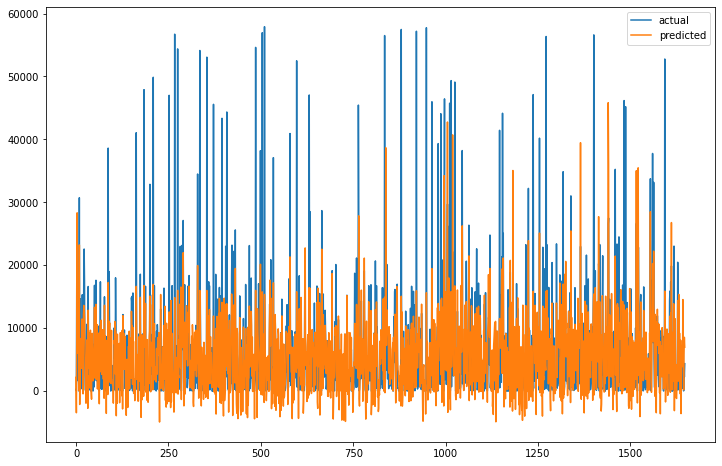

In [339]:
start_l_t = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w_c, test_size = 0.4, random_state = 0)

# create model
model2 = linear_model.LassoCV(normalize = True)
model2.fit(trainX, trainY)

end_l_t = time.time()
print('Tuning the LASSO model took', end_l_t - start_l_t, 'seconds')

trainPred = model2.predict(trainX)
testPred = model2.predict(testX)
train_MAE_overall_c.append(mean_absolute_error(trainY,trainPred))
test_MAE_overall_c.append(mean_absolute_error(testY,testPred))
train_R2_overall_c.append(r2_score(trainY,trainPred))
test_R2_overall_c.append(r2_score(testY,testPred))
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))

# store best alpha
print('alpha:', model2.alpha_)
alphaO_c_lasso = model2.alpha_

# plot model
plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred, label="predicted")
plt.legend()

Now we will do this for the individual dataset.

state index = 52
state = Washington
alpha: 0.09463184958762286
MAE-> train : 238.129, test : 230.610
R2-> train : 0.964, test : 0.966
    
state index = 15
state = Illinois
alpha: 0.4470204836195709
MAE-> train : 1225.368, test : 1307.828
R2-> train : 0.958, test : 0.953
    
state index = 5
state = California
alpha: 0.9336144233377802
MAE-> train : 4979.031, test : 4918.353
R2-> train : 0.870, test : 0.861
    
state index = 3
state = Arizona
alpha: 0.4291294478971179
MAE-> train : 1394.798, test : 1338.608
R2-> train : 0.900, test : 0.901
    
state index = 23
state = Massachusetts
alpha: 0.7030893071292835
MAE-> train : 904.536, test : 959.423
R2-> train : 0.948, test : 0.943
    
state index = 54
state = Wisconsin
alpha: 0.14421981805798195
MAE-> train : 740.997, test : 731.550
R2-> train : 0.878, test : 0.871
    
state index = 47
state = Texas
alpha: 12.757495097442415
MAE-> train : 3587.230, test : 3777.828
R2-> train : 0.924, test : 0.917
    
state index = 29
state = Nebraska


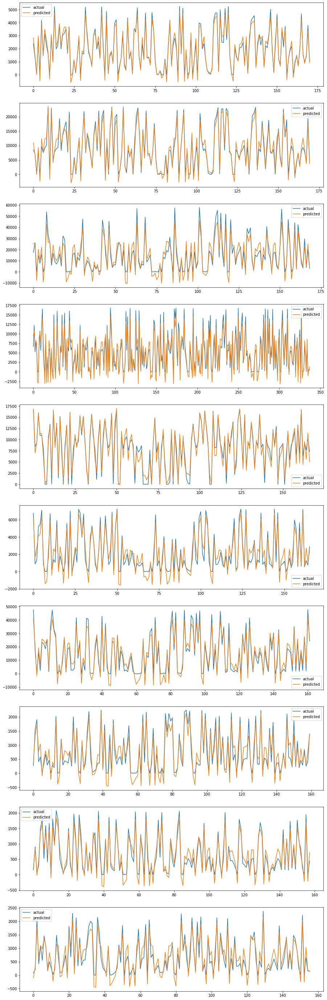

In [340]:
alpha_O_c_lasso = []

start = time.time() # time how long it takes to find the model

# allow multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

for i in range(10):
  # create temporary dataset
  temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 5]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model_l_i = linear_model.LassoCV(normalize = True)
  model_l_i.fit(trainX, trainY)

  trainPred = model_l_i.predict(trainX)
  testPred = model_l_i.predict(testX)

  train_MAE_indiv_c[i].append(mean_absolute_error(trainY,trainPred))
  test_MAE_indiv_c[i].append(mean_absolute_error(testY,testPred))
  train_R2_indiv_c[i].append(r2_score(trainY,trainPred))
  test_R2_indiv_c[i].append(r2_score(testY,testPred))

  alpha_O_c_lasso.append(model_r_i.alpha_)

  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('alpha:', model_l_i.alpha_)
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred), mean_absolute_error(testY,testPred)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred), r2_score(testY,testPred)))
  print('    ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred, label="predicted")
  axes[i].legend()

end = time.time()
print('Tuning the LASSO models took', end - start, 'seconds')

### Elastic-net Regression Tuning

Now we will tune the elastic-net regression model, where we will tune the $\alpha$ and the L1-ratio parameters. For the sklearn implimentation of the Elastic-net regression model, the hyperparameters are $\alpha$ and L1-ratio, where $\alpha$ = a + b and L1-ratio = a / (a + b), and a * L1 + b * L2.

First, we will use the count per day data, and then with the cumulative count data.

We tune the hyperparameters of the model first using the overall dataset.

Tuning the elastic-net model took 1.2591867446899414 seconds
MAE-> train : 35.179, test : 30.805
R2-> train : 0.476, test : 0.436
alpha: 0.0014646597897974257
l1_ratio: 0.9


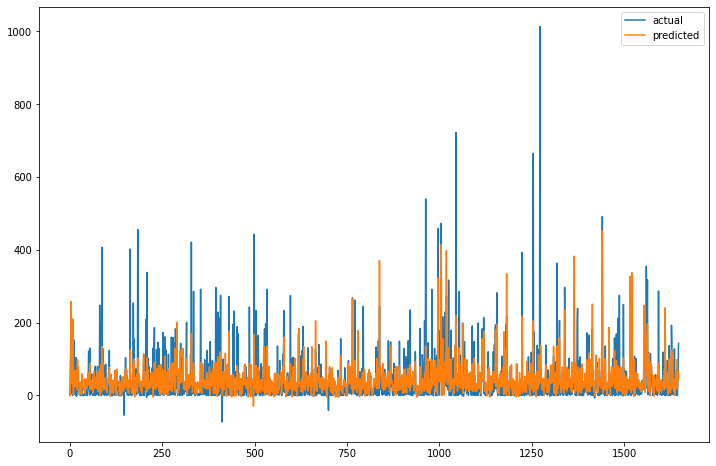

In [341]:
l1Values = np.linspace(0.6, 0.9, 20)

start_3 = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w, test_size = 0.4, random_state = 0)

# create model
model3_t = linear_model.ElasticNetCV(l1_ratio = l1Values, normalize = True)
model3_t.fit(trainX, trainY)

end_3 = time.time()
print('Tuning the elastic-net model took', end_3 - start_3, 'seconds')

trainPred3e = model3_t.predict(trainX)
testPred3e = model3_t.predict(testX)
train_MAE_overall.append(mean_absolute_error(trainY,trainPred3e))
test_MAE_overall.append(mean_absolute_error(testY,testPred3e))
train_R2_overall.append(r2_score(trainY,trainPred3e))
test_R2_overall.append(r2_score(testY,testPred3e))
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred3e), mean_absolute_error(testY,testPred3e)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred3e), r2_score(testY,testPred3e)))

# save alpha and l1-ratio
print('alpha:', model3_t.alpha_)
print('l1_ratio:', model3_t.l1_ratio_)
alphaO_elastic = model3_t.alpha_
l1O_elastic = model3_t.l1_ratio_

# plot model
plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred3e, label="predicted")
plt.legend()

From this, we find that the optimal $\alpha$ and L1-ratio values as 0.0015 and 0.9, respectively.

The L1-ratio value of 0.9 means that the elastic-net regression that works the best for the overall dataset is closer to LASSO regression (L1 regularization) than ridge regression (L2 regression).

Now, we will repeat this process for each individual state. 

state index = 52
state = Washington
alpha: 0.0006636781658976022
l1_ratio: 0.6894736842105262
MAE-> train : 8.499, test : 9.947
R2-> train : 0.267, test : 0.153
    
state index = 15
state = Illinois
alpha: 0.002655896761038532
l1_ratio: 0.9
MAE-> train : 33.633, test : 28.458
R2-> train : 0.432, test : 0.473
    
state index = 5
state = California
alpha: 0.0066895165396275
l1_ratio: 0.9
MAE-> train : 69.294, test : 73.962
R2-> train : 0.477, test : 0.526
    
state index = 3
state = Arizona
alpha: 0.0016033147230149131
l1_ratio: 0.9
MAE-> train : 28.784, test : 27.597
R2-> train : 0.357, test : 0.380
    
state index = 23
state = Massachusetts
alpha: 0.00149468910535688
l1_ratio: 0.8578947368421053
MAE-> train : 26.466, test : 26.504
R2-> train : 0.271, test : 0.225
    
state index = 54
state = Wisconsin
alpha: 0.001232523437184782
l1_ratio: 0.9
MAE-> train : 10.383, test : 10.797
R2-> train : 0.532, test : 0.570
    
state index = 47
state = Texas
alpha: 0.007652784899405227
l1_rati

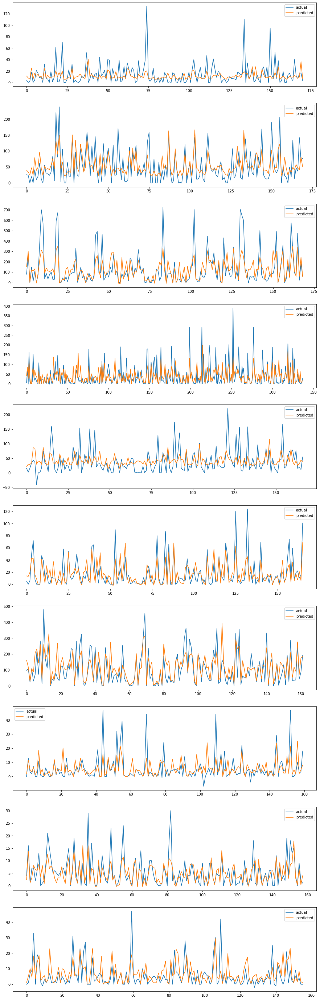

In [342]:
l1Values = np.linspace(0.1, 0.9, 20)

alpha_O_elastic = []
l1_O_elastic = []

start_3 = time.time() # time how long it takes to find the model

# allow multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

for i in range(10):
  # create temporary dataset
  temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 10]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model3_r_i = linear_model.ElasticNetCV(l1_ratio = l1Values, normalize = True)
  model3_r_i.fit(trainX, trainY)

  trainPred3e = model3_r_i.predict(trainX)
  testPred3e = model3_r_i.predict(testX)

  train_MAE_indiv[i].append(mean_absolute_error(trainY,trainPred3e))
  test_MAE_indiv[i].append(mean_absolute_error(testY,testPred3e))
  train_R2_indiv[i].append(r2_score(trainY,trainPred3e))
  test_R2_indiv[i].append(r2_score(testY,testPred3e))

  alpha_O_elastic.append(model3_r_i.alpha_)
  l1_O_elastic.append(model3_r_i.l1_ratio_)

  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('alpha:', model3_r_i.alpha_)
  print('l1_ratio:', model3_r_i.l1_ratio_)
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred3e), mean_absolute_error(testY,testPred3e)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred3e), r2_score(testY,testPred3e)))
  print('    ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred3e, label="predicted")
  axes[i].legend()

end_3 = time.time()
print('Tuning the elastic-net models took', end_3 - start_3, 'seconds')

We will now repeat the tuning with the cumulative count data.

Tuning the elastic-net model took 1.2339723110198975 seconds
MAE-> train : 6533.448, test : 6270.765
R2-> train : 0.046, test : 0.039
alpha: 0.121860487294421
l1_ratio: 0.9


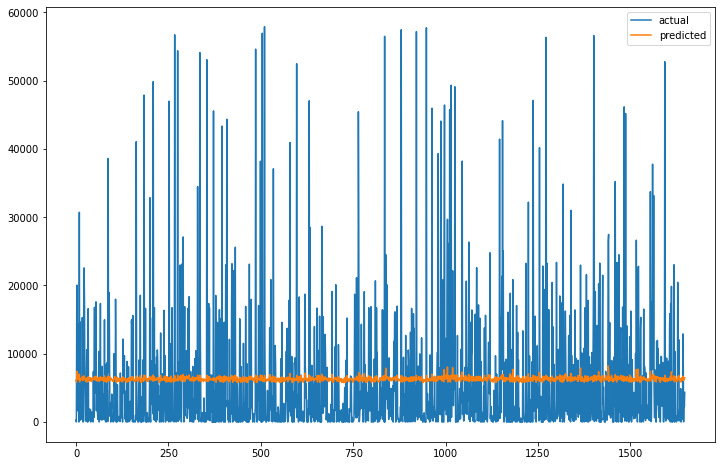

In [343]:
l1Values = np.linspace(0.6, 0.9, 20)

start_3 = time.time() # time how long it takes to find the model

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w_c, test_size = 0.4, random_state = 0)

# create model
model3_t = linear_model.ElasticNetCV(l1_ratio = l1Values, normalize = True)
model3_t.fit(trainX, trainY)

end_3 = time.time()
print('Tuning the elastic-net model took', end_3 - start_3, 'seconds')

trainPred3e = model3_t.predict(trainX)
testPred3e = model3_t.predict(testX)
train_MAE_overall_c.append(mean_absolute_error(trainY,trainPred3e))
test_MAE_overall_c.append(mean_absolute_error(testY,testPred3e))
train_R2_overall_c.append(r2_score(trainY,trainPred3e))
test_R2_overall_c.append(r2_score(testY,testPred3e))
print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred3e), mean_absolute_error(testY,testPred3e)))
print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred3e), r2_score(testY,testPred3e)))

# save alpha and l1-ratio
print('alpha:', model3_t.alpha_)
print('l1_ratio:', model3_t.l1_ratio_)
alphaO_c_elastic = model3_t.alpha_
l1O_c_elastic = model3_t.l1_ratio_

# plot model
plt.figure(figsize=(12,8))
plt.plot(testY,label="actual")
plt.plot(testPred3e, label="predicted")
plt.legend()

We will now repeat for the individual state data.

state index = 52
state = Washington
alpha: 0.10514649954180318
l1_ratio: 0.9
MAE-> train : 843.517, test : 867.916
R2-> train : 0.483, test : 0.492
    
state index = 15
state = Illinois
alpha: 0.4966894262439676
l1_ratio: 0.9
MAE-> train : 5392.395, test : 5486.896
R2-> train : 0.147, test : 0.149
    
state index = 5
state = California
alpha: 1.0373493592642
l1_ratio: 0.9
MAE-> train : 11882.818, test : 11651.977
R2-> train : 0.067, test : 0.070
    
state index = 3
state = Arizona
alpha: 0.23730970825919825
l1_ratio: 0.9
MAE-> train : 3705.112, test : 3577.374
R2-> train : 0.145, test : 0.151
    
state index = 23
state = Massachusetts
alpha: 0.3381673077605286
l1_ratio: 0.9
MAE-> train : 3417.036, test : 3385.438
R2-> train : 0.211, test : 0.209
    
state index = 54
state = Wisconsin
alpha: 0.16024424228664655
l1_ratio: 0.9
MAE-> train : 1774.104, test : 1708.122
R2-> train : 0.313, test : 0.314
    
state index = 47
state = Texas
alpha: 1.0000178432490943
l1_ratio: 0.9
MAE-> trai

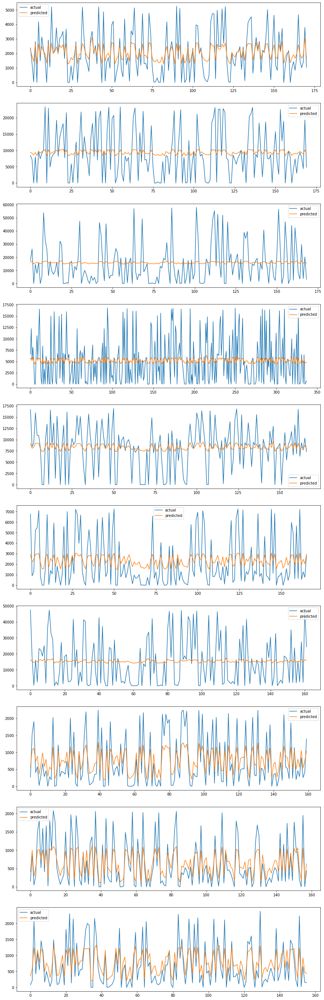

In [344]:
l1Values = np.linspace(0.1, 0.9, 20)

alpha_O_c_elastic = []
l1_O_c_elastic = []

start_3 = time.time() # time how long it takes to find the model

# allow multiple plots
fig, axes = plt.subplots(nrows = 10, figsize = (15,50))

for i in range(10):
  # create temporary dataset
  temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[i]].to_numpy()

  # split data into X and Y components
  X = temp[:, 6:10]
  Y = temp[:, 5]

  # split the data into training and testing
  (trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

  # create model
  model3_r_i = linear_model.ElasticNetCV(l1_ratio = l1Values, normalize = True)
  model3_r_i.fit(trainX, trainY)

  trainPred3e = model3_r_i.predict(trainX)
  testPred3e = model3_r_i.predict(testX)

  train_MAE_indiv_c[i].append(mean_absolute_error(trainY,trainPred3e))
  test_MAE_indiv_c[i].append(mean_absolute_error(testY,testPred3e))
  train_R2_indiv_c[i].append(r2_score(trainY,trainPred3e))
  test_R2_indiv_c[i].append(r2_score(testY,testPred3e))

  alpha_O_c_elastic.append(model3_r_i.alpha_)
  l1_O_c_elastic.append(model3_r_i.l1_ratio_)

  print('state index =', unique_state_index_list[i])
  print('state =', unique_state_name_list[i])
  print('alpha:', model3_r_i.alpha_)
  print('l1_ratio:', model3_r_i.l1_ratio_)
  print('MAE-> train : %.3f, test : %.3f' % (mean_absolute_error(trainY,trainPred3e), mean_absolute_error(testY,testPred3e)))
  print('R2-> train : %.3f, test : %.3f' % (r2_score(trainY,trainPred3e), r2_score(testY,testPred3e)))
  print('    ')

  # plot model
  axes[i].plot(testY,label="actual")
  axes[i].plot(testPred3e, label="predicted")
  axes[i].legend()

end_3 = time.time()
print('Tuning the elastic-net models took', end_3 - start_3, 'seconds')

# Conclusions

### Overall Dataset- Counts Per Day Data

For the overall dataset, we will check those values of all of the models that were used. Specifically, we can compare the training and testing MAE and $R^2$ values using the barplots below.

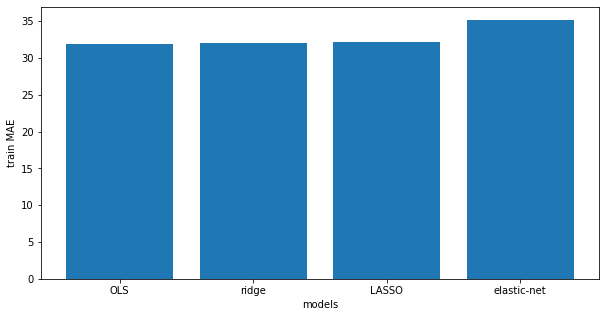

In [345]:
fig = plt.figure(figsize = (10, 5))

# creating the bar plot
plt.bar(["OLS", "ridge", "LASSO", "elastic-net"], train_MAE_overall, width = 0.8)
 
plt.xlabel("models")
plt.ylabel("train MAE")
plt.show()

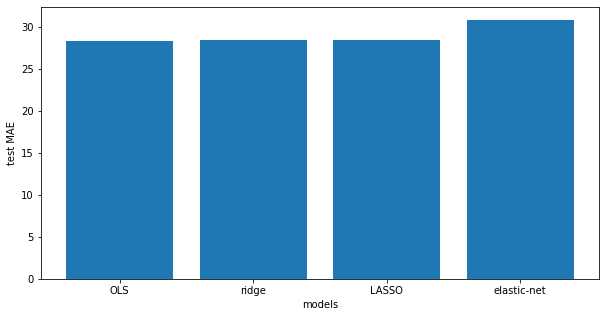

In [346]:
fig = plt.figure(figsize = (10, 5))

# creating the bar plot
plt.bar(["OLS", "ridge", "LASSO", "elastic-net"], test_MAE_overall, width = 0.8)
 
plt.xlabel("models")
plt.ylabel("test MAE")
plt.show()

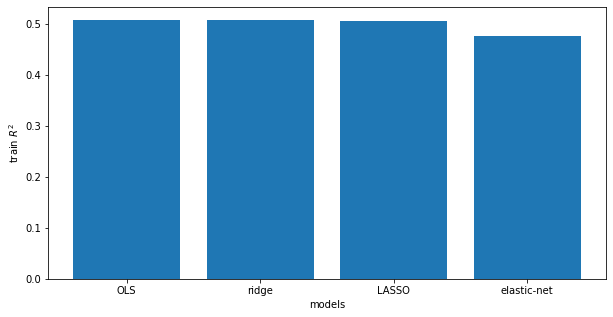

In [347]:
fig = plt.figure(figsize = (10, 5))

# creating the bar plot
plt.bar(["OLS", "ridge", "LASSO", "elastic-net"], train_R2_overall, width = 0.8)
 
plt.xlabel("models")
plt.ylabel("train $R^2$")
plt.show()

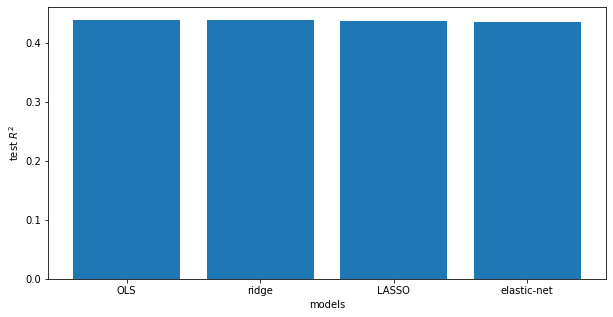

In [348]:
fig = plt.figure(figsize = (10, 5))

# creating the bar plot
plt.bar(["OLS", "ridge", "LASSO", "elastic-net"], test_R2_overall, width = 0.8)
 
plt.xlabel("models")
plt.ylabel("test $R^2$")
plt.show()

We can see that overall, the best models in terms of MAE and $R^2$ are the LASSO and elastic-net regression models.

### Overall Dataset- Cumulative Count Data

For the overall dataset, we will again check those values of all of the models that were used, but now with the models that used the cumulative count data. 

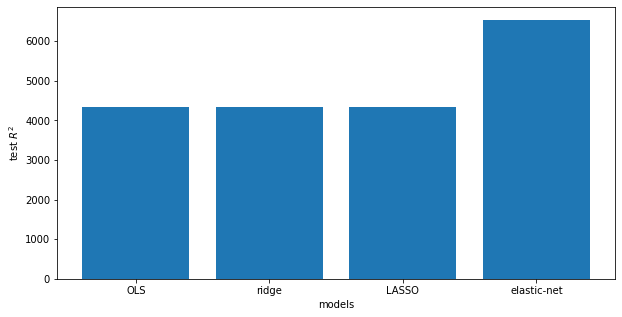

In [349]:
fig = plt.figure(figsize = (10, 5))

# creating the bar plot
plt.bar(["OLS", "ridge", "LASSO", "elastic-net"], train_MAE_overall_c, width = 0.8)
 
plt.xlabel("models")
plt.ylabel("test $R^2$")
plt.show()

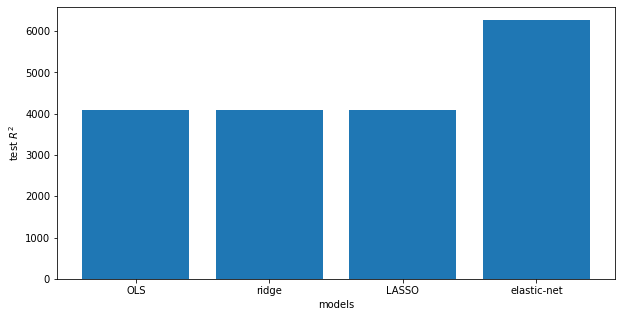

In [350]:
fig = plt.figure(figsize = (10, 5))

# creating the bar plot
plt.bar(["OLS", "ridge", "LASSO", "elastic-net"], test_MAE_overall_c, width = 0.8)
 
plt.xlabel("models")
plt.ylabel("test $R^2$")
plt.show()

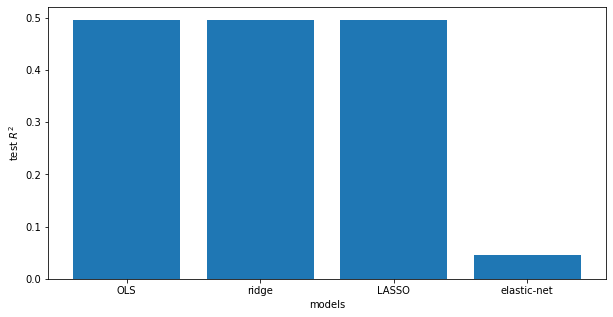

In [351]:
fig = plt.figure(figsize = (10, 5))

# creating the bar plot
plt.bar(["OLS", "ridge", "LASSO", "elastic-net"], train_R2_overall_c, width = 0.8)
 
plt.xlabel("models")
plt.ylabel("test $R^2$")
plt.show()

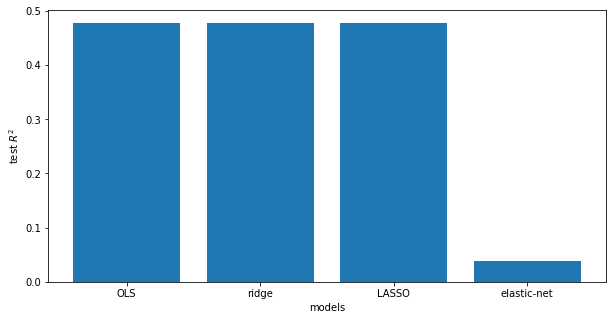

In [352]:
fig = plt.figure(figsize = (10, 5))

# creating the bar plot
plt.bar(["OLS", "ridge", "LASSO", "elastic-net"], test_R2_overall_c, width = 0.8)
 
plt.xlabel("models")
plt.ylabel("test $R^2$")
plt.show()

Again, we get similar results as with the count per day data. The bets models are between OLS, ridge regression and LASSO regression.

### Individual State Dataset- Counts Per Day Data

Now we will repeat this process for each individual state. However, first we need to remove the first 2 values of each column of each list, since those values are unneeded and were only introduced to initalize the list.

In [353]:
train_MAE_indiv_2 = [v[2:6] for v in train_MAE_indiv]
test_MAE_indiv_2 = [v[2:6] for v in test_MAE_indiv]
train_R2_indiv_2 = [v[2:6] for v in train_R2_indiv]
test_R2_indiv_2 = [v[2:6] for v in test_R2_indiv]

Now, we will plot the bar plots.

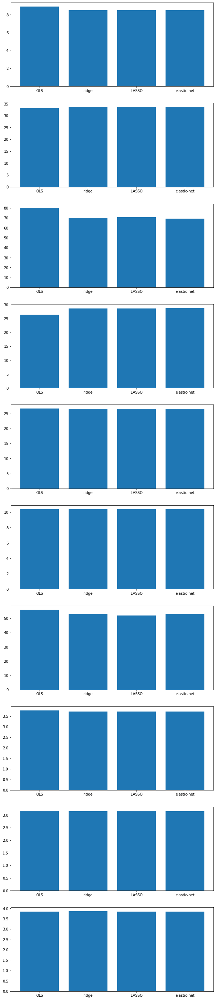

In [354]:
fig, axes = plt.subplots(nrows = 10, figsize = (10,50))

for i in range(10):
  axes[i].bar(["OLS", "ridge", "LASSO", "elastic-net"], train_MAE_indiv_2[i], width = 0.8)

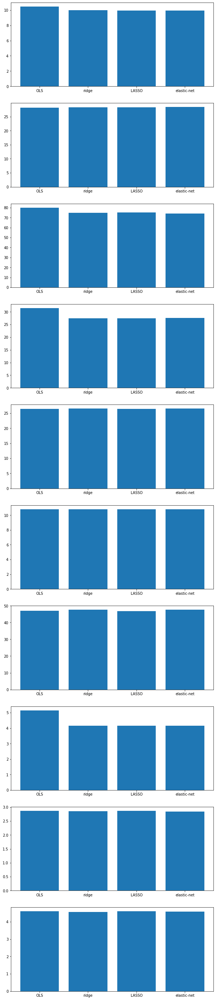

In [355]:
fig, axes = plt.subplots(nrows = 10, figsize = (10,50))

for i in range(10):
  axes[i].bar(["OLS", "ridge", "LASSO", "elastic-net"], test_MAE_indiv_2[i], width = 0.8)

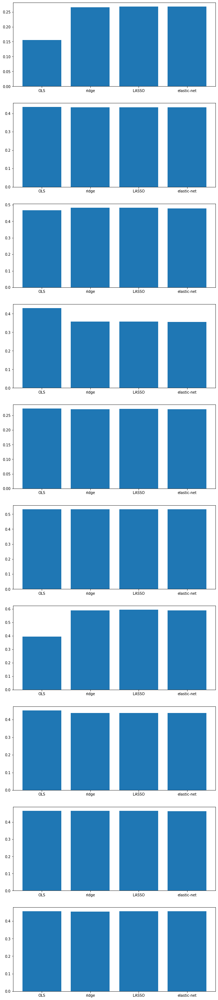

In [356]:
fig, axes = plt.subplots(nrows = 10, figsize = (10,50))

for i in range(10):
  axes[i].bar(["OLS", "ridge", "LASSO", "elastic-net"], train_R2_indiv_2[i], width = 0.8)

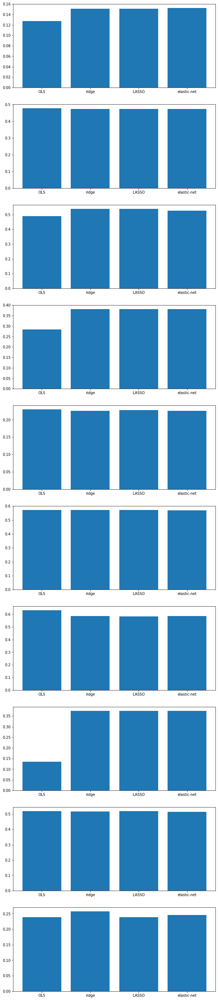

In [357]:
fig, axes = plt.subplots(nrows = 10, figsize = (10,50))

for i in range(10):
  axes[i].bar(["OLS", "ridge", "LASSO", "elastic-net"], test_R2_indiv_2[i], width = 0.8)

It can be seen that for most states, using different regularizations does not matter. Based off the tuned values, the models are very close to each other, with the elastic-net regression model having a very high L1-ratio. 

Another type of model, other than a standard linear regression model, may be able to predict this data better. 

We see, using the count per day data, the best models for each of the individual states are listed below.

1. Washington: elastic-net
2. Illinois: OLS/ridge/LASSO/elastic-net
3. California: ridge/LASSO
4. Arizona: ridge/LASSO/elastic-net
5. Massachusetts: OLS
6. Wisconsin: OLS/ridge/LASSO/elastic-net
7. Texas: OLS
8. Nebraska: ridge/LASSO/elastic-net
9. Utah: OLS/ridge/LASSO/elastic-net
10. Oregon: ridge

### Individual State Dataset- Cumulative Count Data

Now we will repeat this process for each individual state using the cumulative count data. Again, first we need to remove the first 2 values of each column of each list, since those values are unneeded and were only introduced to initalize the list.

In [358]:
train_MAE_indiv_c_2 = [v[2:6] for v in train_MAE_indiv]
test_MAE_indiv_c_2 = [v[2:6] for v in test_MAE_indiv]
train_R2_indiv_c_2 = [v[2:6] for v in train_R2_indiv]
test_R2_indiv_c_2 = [v[2:6] for v in test_R2_indiv]

Now we will plot the bar plots.

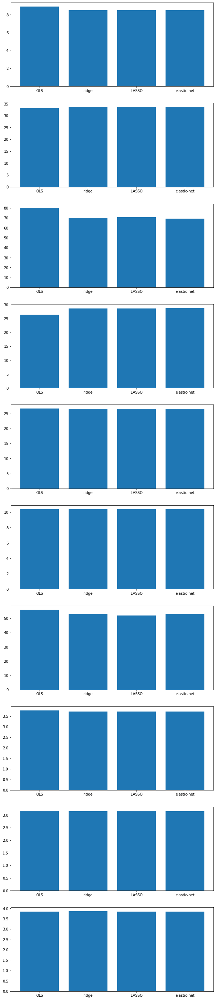

In [359]:
fig, axes = plt.subplots(nrows = 10, figsize = (10,50))

for i in range(10):
  axes[i].bar(["OLS", "ridge", "LASSO", "elastic-net"], train_MAE_indiv_c_2[i], width = 0.8)

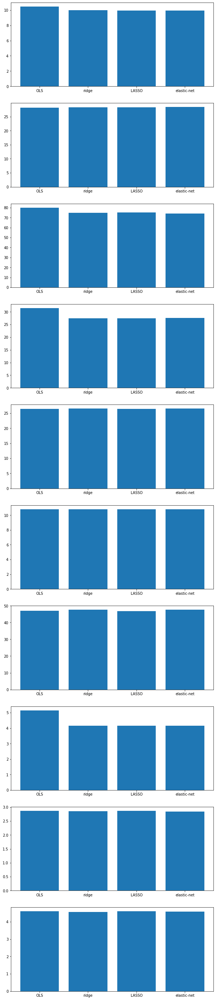

In [360]:
fig, axes = plt.subplots(nrows = 10, figsize = (10,50))

for i in range(10):
  axes[i].bar(["OLS", "ridge", "LASSO", "elastic-net"], test_MAE_indiv_c_2[i], width = 0.8)

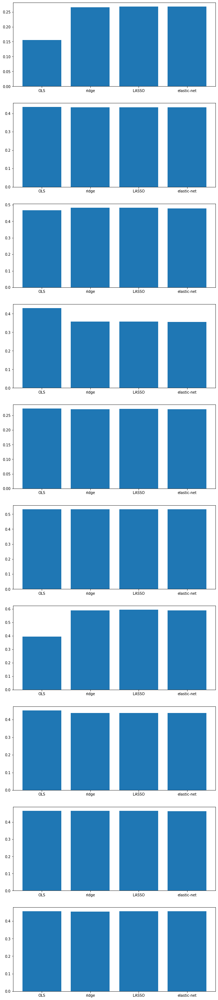

In [361]:
fig, axes = plt.subplots(nrows = 10, figsize = (10,50))

for i in range(10):
  axes[i].bar(["OLS", "ridge", "LASSO", "elastic-net"], train_R2_indiv_c_2[i], width = 0.8)

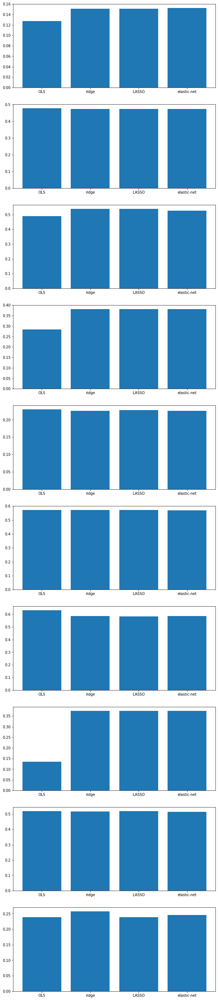

In [362]:
fig, axes = plt.subplots(nrows = 10, figsize = (10,50))

for i in range(10):
  axes[i].bar(["OLS", "ridge", "LASSO", "elastic-net"], test_R2_indiv_c_2[i], width = 0.8)

Using the cumulative count data, the best models for each of the individual states are listed below.

1. Washington: elastic-net
2. Illinois: OLS
3. California: LASSO
4. Arizona: ridge/LASSO/elastic-net
5. Massachusetts: OLS
6. Wisconsin: OLS/ridge/LASSO/elastic-net
7. Texas: OLS
8. Nebraska: ridge/LASSO/elastic-net
9. Utah: OLS
10. Oregon: ridge

### Testing the Extra State

Now, we want to see if the overall dataset models can predict the extra testing state data that was not used.

 We will use LASSO (since the elastic regresssion model was tuned and ended up being very similar to the LASSO model) to test the extra state dataset.

LASSO took 0.00745391845703125 seconds
MAE-> test : 48.207
R2-> test : 0.119


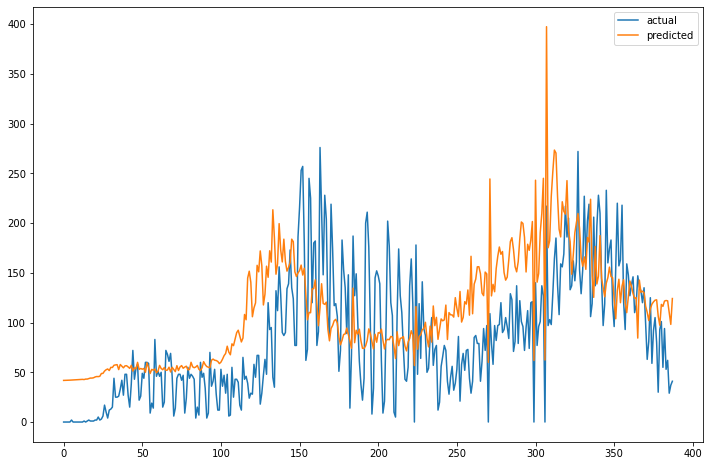

In [369]:
start_2_l = time.time() # time how long it takes to find the model

# split new state into X and Y
X_extra = state_10[:, 6:10]
Y_extra = state_10[:, 10]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w, test_size = 0.4, random_state = 0)

# create model
model_l = linear_model.Lasso(alpha = alphaO_lasso, normalize = True)

# fit model
model_l.fit(trainX, trainY)

end_2_l = time.time()
print('LASSO took', end_2_l - start_2_l, 'seconds')

# test model
testPred2 = model_l.predict(X_extra)
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred2)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred2)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred2, label="predicted")
plt.legend()
plt.show()

It can be seen for this model that while the prediciton criteria are not good, this model produces predicted values that looks very similar to the testing data, but has some displacement to the left. 

We will repeat this for the overall dataset with the cumulative count data.

LASSO took 0.01085972785949707 seconds
MAE-> test : 5991.876
R2-> test : 0.524


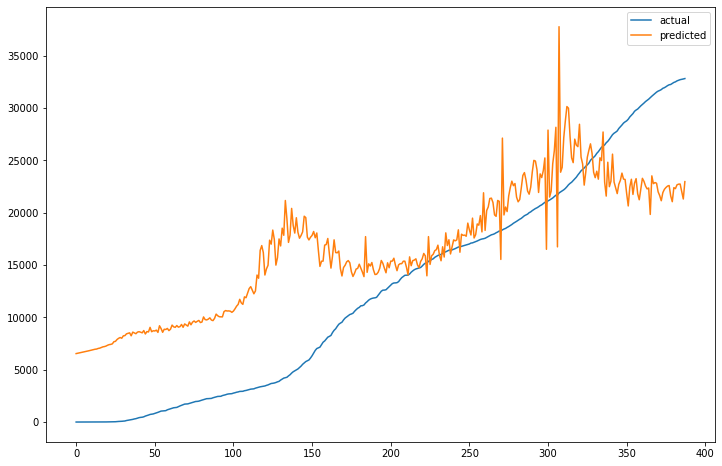

In [378]:
start_2_l = time.time() # time how long it takes to find the model

# split new state into X and Y
X_extra = state_10[:, 6:10]
Y_extra_c = state_10[:, 5]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X_w, Y_w_c, test_size = 0.4, random_state = 0)

# create model
model_l = linear_model.Lasso(alpha = alphaO_c_lasso, normalize = True)

# fit model
model_l.fit(trainX, trainY)

end_2_l = time.time()
print('LASSO took', end_2_l - start_2_l, 'seconds')

# test model
testPred2 = model_l.predict(X_extra)
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra_c,testPred2)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred2)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred2, label="predicted")
plt.legend()
plt.show()

The prediction using the overall dataset does not do as well for the cumulative count dataset.

Now we will do this for the individual states. We will run the best model found for each of the states, and then test if those models can predict the new test data well. 

State: Washington
MAE-> test : 49.473
R2-> test : -0.220


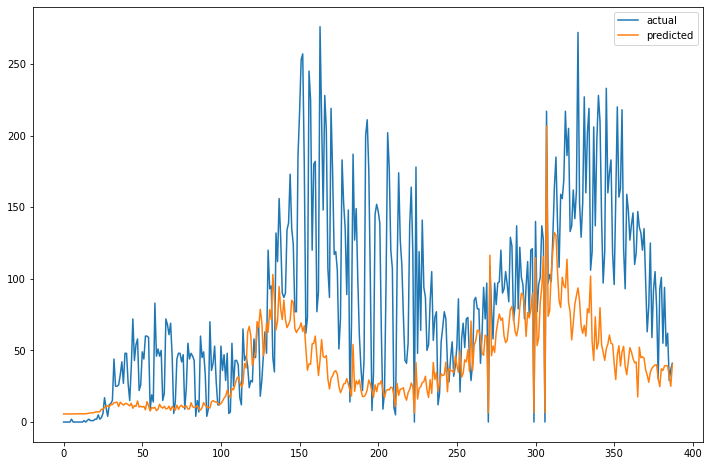

State: Illinois
MAE-> test : 41.363
R2-> test : 0.229


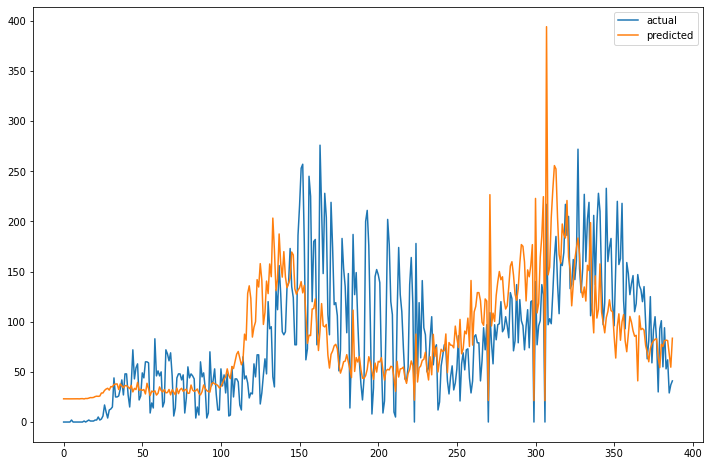

State: California
MAE-> test : 61.749
R2-> test : -0.602


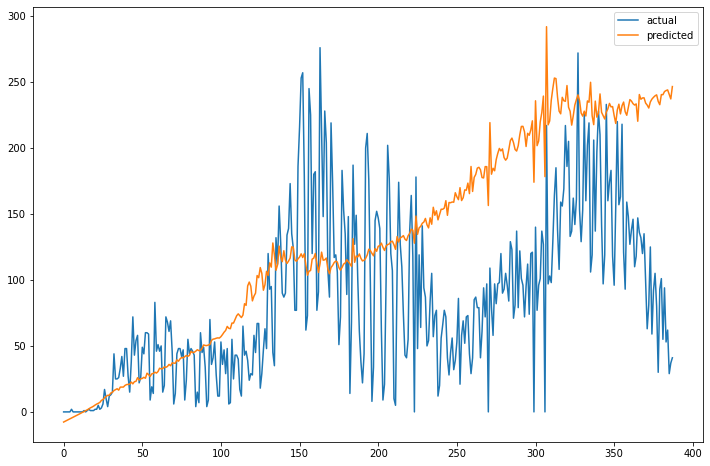

State: Arizona
MAE-> test : 38.689
R2-> test : 0.272


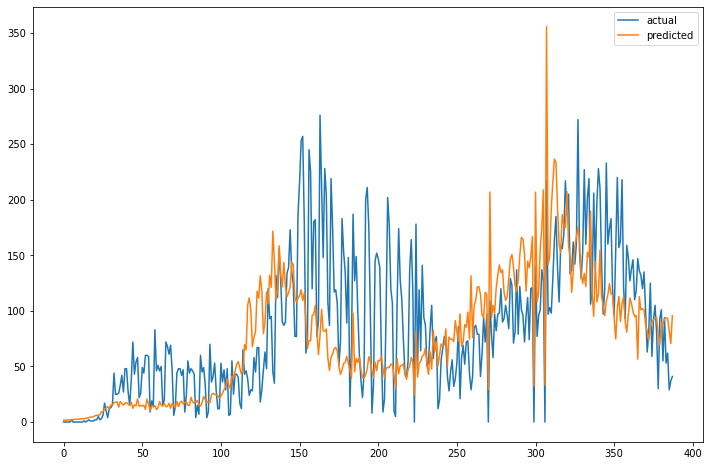

State: Massachusetts
MAE-> test : 46.123
R2-> test : 0.078


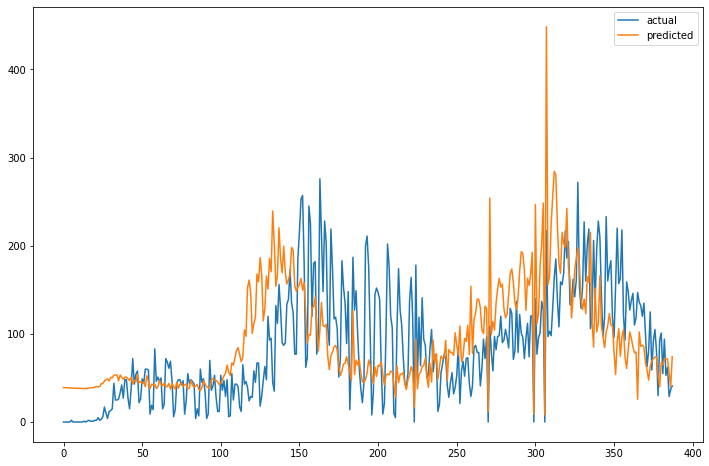

State: Wisconsin
MAE-> test : 43.604
R2-> test : 0.000


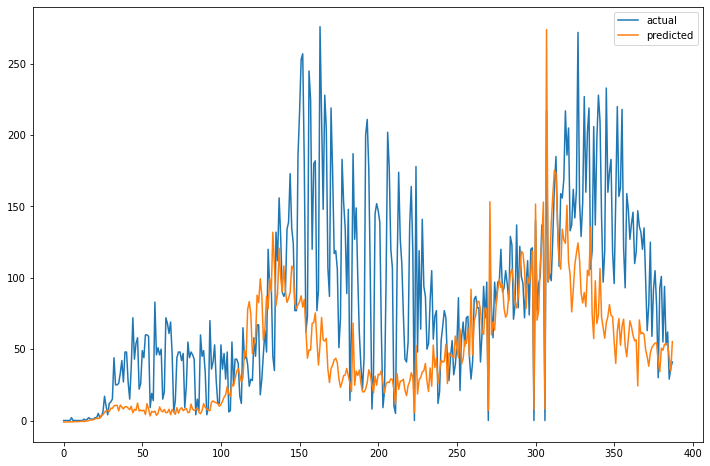

State: Texas
MAE-> test : 50.012
R2-> test : -0.024


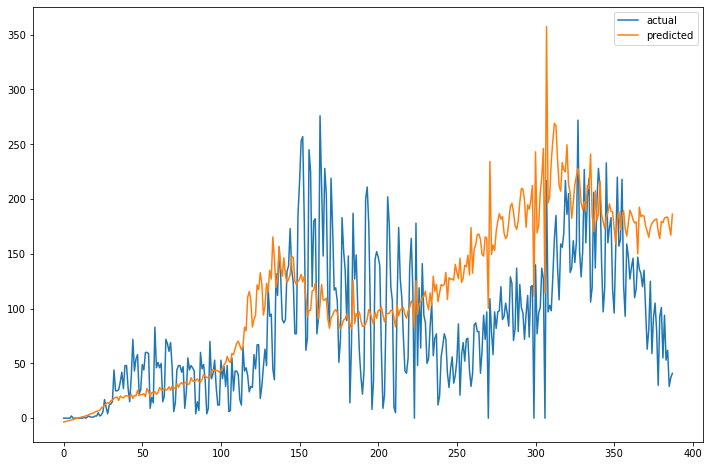

State: Nebraska
MAE-> test : 45.068
R2-> test : -0.059


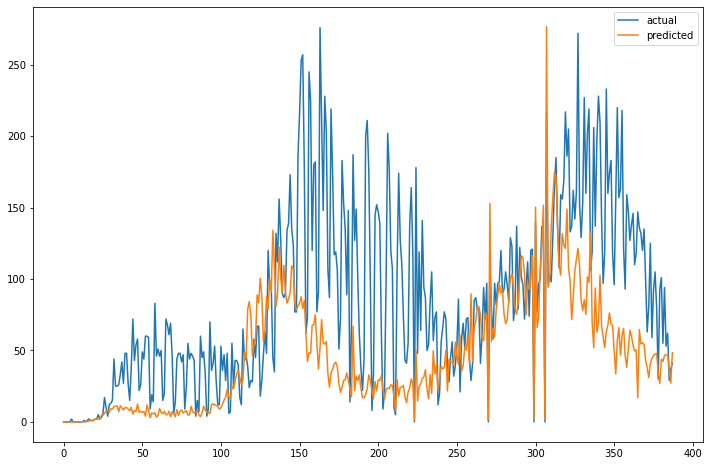

State: Utah
MAE-> test : 68.328
R2-> test : -0.986


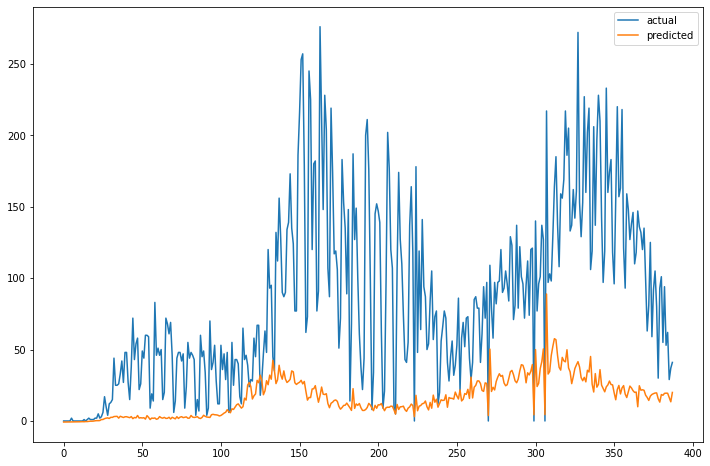

State: Oregon
MAE-> test : 42.268
R2-> test : 0.117


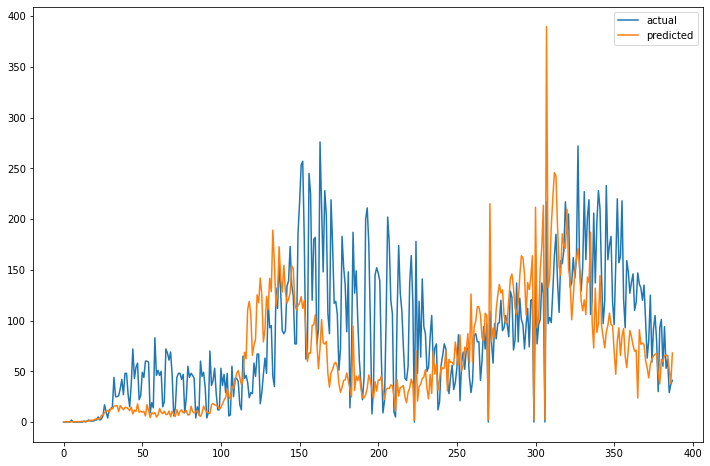

In [385]:
Y_extra = state_10[:, 10]

# Washington: elastic-net
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[0]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 10]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Wash_cpd = linear_model.ElasticNet(alpha = alpha_O_elastic[0], l1_ratio = l1_O_elastic[0], normalize = True)
model_Wash_cpd.fit(trainX, trainY)

# test model
testPred_w = model_Wash_cpd.predict(X_extra)
print('State:', unique_state_name_list[0])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_w)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_w)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_w, label="predicted")
plt.legend()
plt.show()

# Illinois: OLS
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[1]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 10]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Ill_cpd = linear_model.LinearRegression(normalize = True)
model_Ill_cpd.fit(trainX, trainY)

# test model
testPred_i = model_Ill_cpd.predict(X_extra)
print('State:', unique_state_name_list[1])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_i)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_i)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_i, label="predicted")
plt.legend()
plt.show()

# California: LASSO
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[2]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 10]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Cal_cpd = linear_model.Lasso(alpha = alpha_O_lasso[2], normalize = True)
model_Cal_cpd.fit(trainX, trainY)

# test model
testPred_c = model_Cal_cpd.predict(X_extra)
print('State:', unique_state_name_list[2])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_c)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_c)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_c, label="predicted")
plt.legend()
plt.show()

# Arizona: LASSO
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[3]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 10]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Ariz_cpd = linear_model.Lasso(alpha = alpha_O_lasso[3], normalize = True)
model_Ariz_cpd.fit(trainX, trainY)

# test model
testPred_a = model_Ariz_cpd.predict(X_extra)
print('State:', unique_state_name_list[3])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_a)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_a)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_a, label="predicted")
plt.legend()
plt.show()

# Massachusetts: OLS
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[4]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 10]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Mass_cpd = linear_model.LinearRegression(normalize = True)
model_Mass_cpd.fit(trainX, trainY)

# test model
testPred_m = model_Mass_cpd.predict(X_extra)
print('State:', unique_state_name_list[4])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_m)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_m)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_m, label="predicted")
plt.legend()
plt.show()

# Wisconsin: LASSO
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[5]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 10]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Wisc_cpd = linear_model.Lasso(alpha = alpha_O_lasso[5], normalize = True)
model_Wisc_cpd.fit(trainX, trainY)

# test model
testPred_wi = model_Wisc_cpd.predict(X_extra)
print('State:', unique_state_name_list[5])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_wi)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_wi)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_wi, label="predicted")
plt.legend()
plt.show()

# Texas: OLS
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[6]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 10]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Tex_cpd = linear_model.LinearRegression(normalize = True)
model_Tex_cpd.fit(trainX, trainY)

# test model
testPred_t = model_Tex_cpd.predict(X_extra)
print('State:', unique_state_name_list[6])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_t)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_t)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_t, label="predicted")
plt.legend()
plt.show()

# Nebraska: LASSO
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[7]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 10]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Nebr_cpd = linear_model.Lasso(alpha = alpha_O_lasso[7], normalize = True)
model_Nebr_cpd.fit(trainX, trainY)

# test model
testPred_n = model_Nebr_cpd.predict(X_extra)
print('State:', unique_state_name_list[7])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_n)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_n)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_n, label="predicted")
plt.legend()
plt.show()

# Utah: OLS
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[8]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 10]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Utah_cpd = linear_model.LinearRegression(normalize = True)
model_Utah_cpd.fit(trainX, trainY)

# test model
testPred_u = model_Utah_cpd.predict(X_extra)
print('State:', unique_state_name_list[8])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_u)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_u)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_u, label="predicted")
plt.legend()
plt.show()

# Oregon: ridge
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[9]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 10]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Oreg_cpd = linear_model.Ridge(alpha = alphas_O_ridge[9], normalize = True)
model_Oreg_cpd.fit(trainX, trainY)
# test model
testPred_o = model_Oreg_cpd.predict(X_extra)
print('State:', unique_state_name_list[9])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_o)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_o)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_o, label="predicted")
plt.legend()
plt.show()

For several of the models, there is the same kind of result as the overall dataset.

We repeat this for the cumulative data.

State: Washington
MAE-> test : 10799.495
R2-> test : -0.948


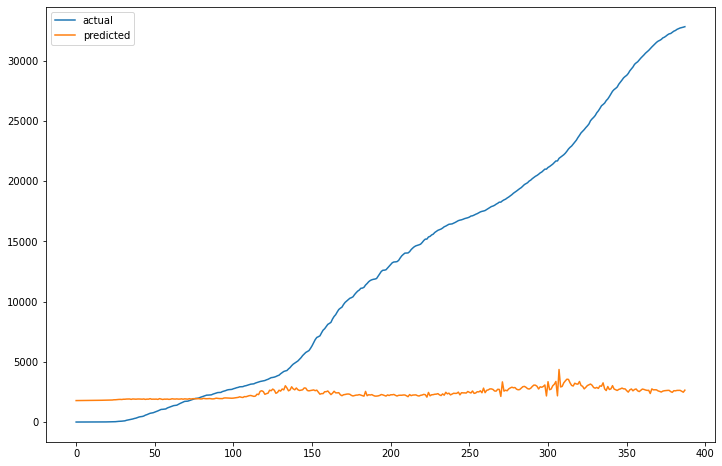

State: Illinois
MAE-> test : 3850.180
R2-> test : 0.744


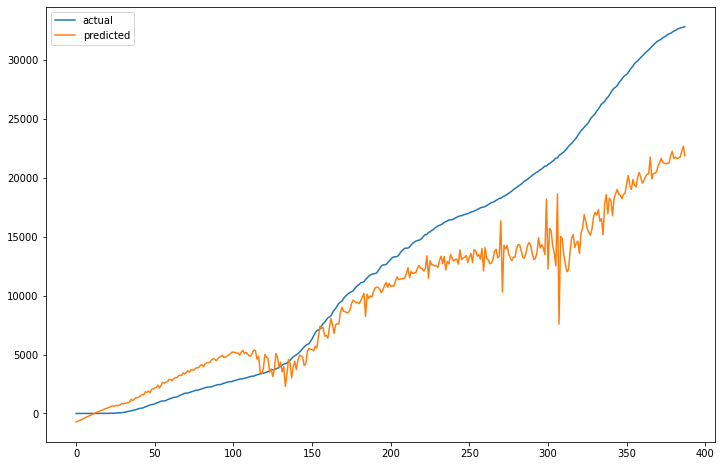

State: California
MAE-> test : 7105.441
R2-> test : 0.406


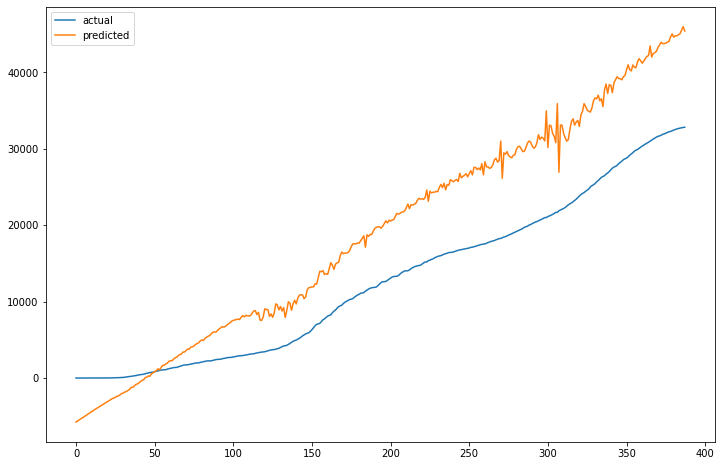

State: Arizona
MAE-> test : 7714.600
R2-> test : 0.063


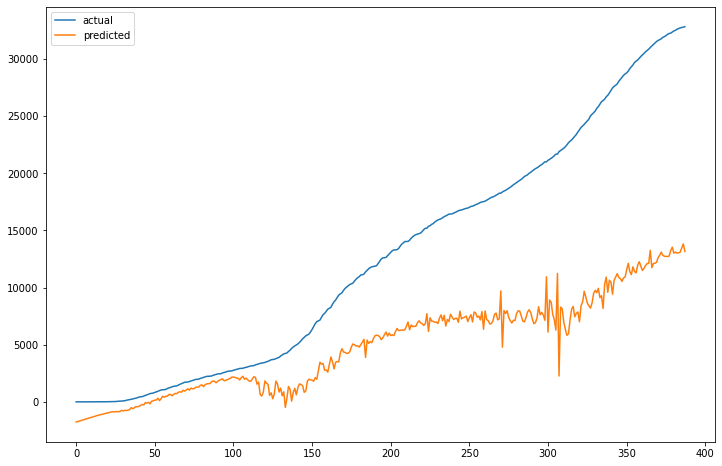

State: Massachusetts
MAE-> test : 6097.046
R2-> test : 0.399


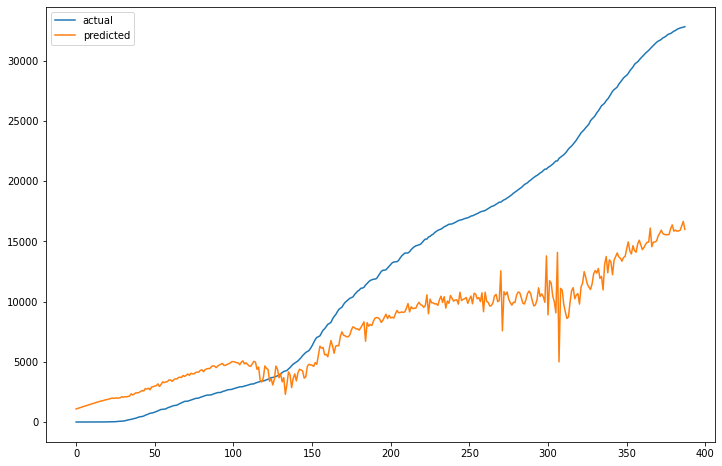

State: Wisconsin
MAE-> test : 11132.598
R2-> test : -0.874


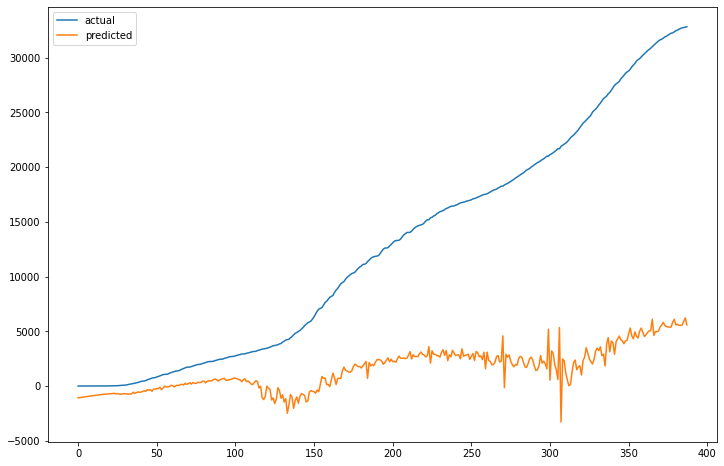

State: Texas
MAE-> test : 5164.207
R2-> test : 0.692


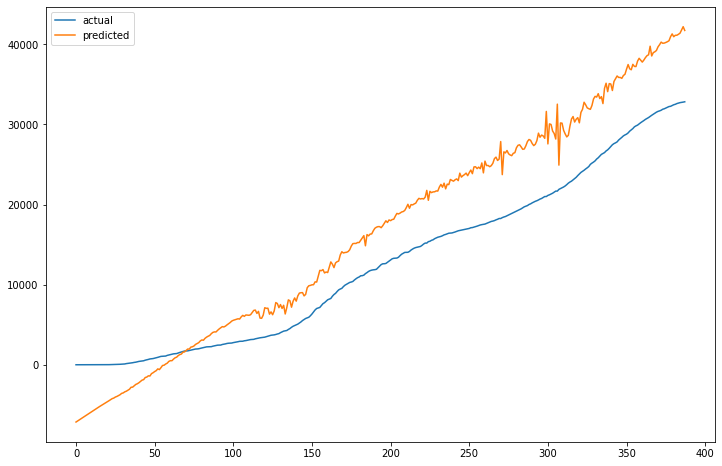

State: Nebraska
MAE-> test : 13024.681
R2-> test : -1.571


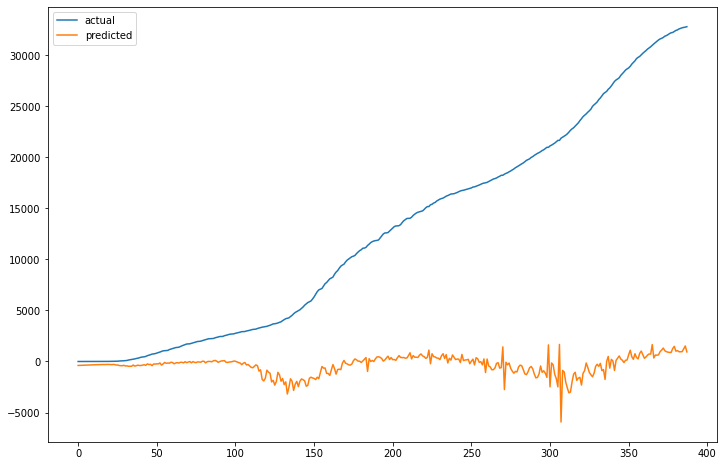

State: Utah
MAE-> test : 12452.362
R2-> test : -1.387


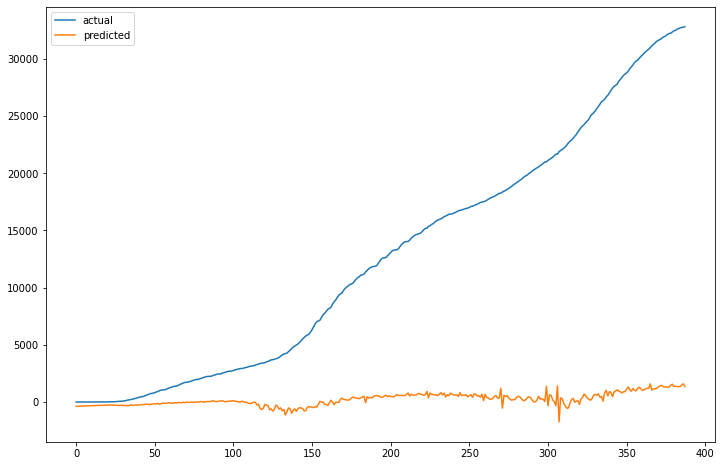

State: Oregon
MAE-> test : 13539.337
R2-> test : -1.742


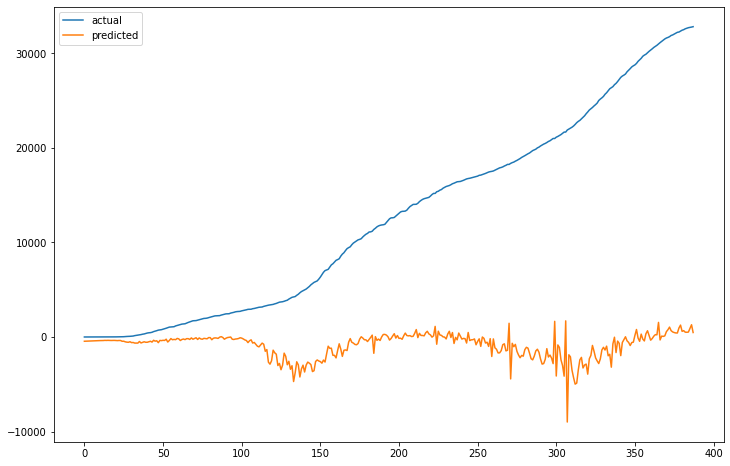

In [386]:
Y_extra = state_10[:, 5]

# Washington: elastic-net
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[0]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 5]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Wash_cpd = linear_model.ElasticNet(alpha = alpha_O_c_elastic[0], l1_ratio = l1_O_elastic[0], normalize = True)
model_Wash_cpd.fit(trainX, trainY)

# test model
testPred_w = model_Wash_cpd.predict(X_extra)
print('State:', unique_state_name_list[0])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_w)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_w)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_w, label="predicted")
plt.legend()
plt.show()

# Illinois: OLS
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[1]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 5]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Ill_cpd = linear_model.LinearRegression(normalize = True)
model_Ill_cpd.fit(trainX, trainY)

# test model
testPred_i = model_Ill_cpd.predict(X_extra)
print('State:', unique_state_name_list[1])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_i)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_i)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_i, label="predicted")
plt.legend()
plt.show()

# California: LASSO
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[2]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 5]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Cal_cpd = linear_model.Lasso(alpha = alpha_O_c_lasso[2], normalize = True)
model_Cal_cpd.fit(trainX, trainY)

# test model
testPred_c = model_Cal_cpd.predict(X_extra)
print('State:', unique_state_name_list[2])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_c)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_c)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_c, label="predicted")
plt.legend()
plt.show()

# Arizona: LASSO
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[3]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 5]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Ariz_cpd = linear_model.Lasso(alpha = alpha_O_c_lasso[3], normalize = True)
model_Ariz_cpd.fit(trainX, trainY)

# test model
testPred_a = model_Ariz_cpd.predict(X_extra)
print('State:', unique_state_name_list[3])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_a)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_a)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_a, label="predicted")
plt.legend()
plt.show()

# Massachusetts: OLS
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[4]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 5]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Mass_cpd = linear_model.LinearRegression(normalize = True)
model_Mass_cpd.fit(trainX, trainY)

# test model
testPred_m = model_Mass_cpd.predict(X_extra)
print('State:', unique_state_name_list[4])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_m)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_m)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_m, label="predicted")
plt.legend()
plt.show()

# Wisconsin: LASSO
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[5]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 5]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Wisc_cpd = linear_model.Lasso(alpha = alpha_O_c_lasso[5], normalize = True)
model_Wisc_cpd.fit(trainX, trainY)

# test model
testPred_wi = model_Wisc_cpd.predict(X_extra)
print('State:', unique_state_name_list[5])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_wi)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_wi)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_wi, label="predicted")
plt.legend()
plt.show()

# Texas: OLS
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[6]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 5]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Tex_cpd = linear_model.LinearRegression(normalize = True)
model_Tex_cpd.fit(trainX, trainY)

# test model
testPred_t = model_Tex_cpd.predict(X_extra)
print('State:', unique_state_name_list[6])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_t)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_t)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_t, label="predicted")
plt.legend()
plt.show()

# Nebraska: LASSO
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[7]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 5]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Nebr_cpd = linear_model.Lasso(alpha = alpha_O_c_lasso[7], normalize = True)
model_Nebr_cpd.fit(trainX, trainY)

# test model
testPred_n = model_Nebr_cpd.predict(X_extra)
print('State:', unique_state_name_list[7])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_n)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_n)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_n, label="predicted")
plt.legend()
plt.show()

# Utah: OLS
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[8]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 5]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Utah_cpd = linear_model.LinearRegression(normalize = True)
model_Utah_cpd.fit(trainX, trainY)

# test model
testPred_u = model_Utah_cpd.predict(X_extra)
print('State:', unique_state_name_list[8])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_u)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_u)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_u, label="predicted")
plt.legend()
plt.show()

# Oregon: ridge
# create temporary dataset
temp = DATA_fil[DATA_fil.state_index == unique_state_index_list[9]].to_numpy()

# split data into X and Y components
X = temp[:, 6:10]
Y = temp[:, 5]

# split the data into training and testing
(trainX, testX, trainY, testY) = train_test_split(X, Y, test_size = 0.4, random_state = 0)

# create model
model_Oreg_cpd = linear_model.Ridge(alpha = alpha_O_c_ridge[9], normalize = True)
model_Oreg_cpd.fit(trainX, trainY)

# test model
testPred_o = model_Oreg_cpd.predict(X_extra)
print('State:', unique_state_name_list[9])
print('MAE-> test : %.3f' % (mean_absolute_error(Y_extra,testPred_o)))
print('R2-> test : %.3f' % (r2_score(Y_extra,testPred_o)))

plt.figure(figsize=(12,8))
plt.plot(Y_extra,label="actual")
plt.plot(testPred_o, label="predicted")
plt.legend()
plt.show()